In [12]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [13]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
# Import to_categorical from the correct location
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split

# Path to your dataset folder
dataset_path = '/content/drive/MyDrive/FireDataset/'

# Initialize empty lists to store data and labels
X = []
Y = []

# Define the folder names
fire_folder = os.path.join(dataset_path, 'Fire')
non_fire_folder = os.path.join(dataset_path, 'No_Fire')

# Load fire images
for file_name in os.listdir(fire_folder):
    img_path = os.path.join(fire_folder, file_name)
    img = cv2.imread(img_path)
    if img is not None:
        img = cv2.resize(img, (32, 32))  # Resize all images to 32x32
        X.append(img)
        Y.append(1)  # Label 1 for fire

# Load non-fire images
for file_name in os.listdir(non_fire_folder):
    img_path = os.path.join(non_fire_folder, file_name)
    img = cv2.imread(img_path)
    if img is not None:
        img = cv2.resize(img, (32, 32))  # Resize all images to 32x32
        X.append(img)
        Y.append(0)  # Label 0 for non-fire

# Convert lists to numpy arrays
X = np.array(X)
Y = np.array(Y)

# Normalize the image data
X = X.astype('float32') / 255.0

# One-hot encode the labels
Y = to_categorical(Y, 2)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

print(f"Training data shape: {X_train.shape}")
print(f"Testing data shape: {X_test.shape}")

Training data shape: (798, 32, 32, 3)
Testing data shape: (200, 32, 32, 3)


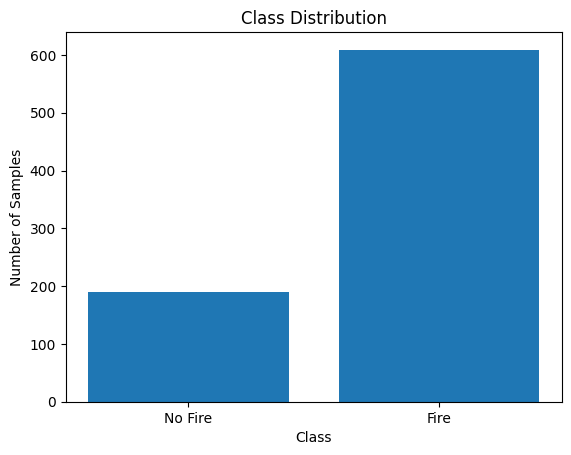

In [14]:
def visualize_class_distribution(Y):
    unique, counts = np.unique(np.argmax(Y, axis=1), return_counts=True)
    plt.bar(['No Fire', 'Fire'], counts)
    plt.title("Class Distribution")
    plt.xlabel("Class")
    plt.ylabel("Number of Samples")
    plt.show()

# Visualize class distribution for training data
visualize_class_distribution(y_train)


In [15]:
from keras.applications import VGG16
from keras.models import Sequential
from keras.layers import Dense, Flatten, MaxPooling2D, Convolution2D
from keras.callbacks import ModelCheckpoint

# Load the VGG16 model
vgg16_base = VGG16(weights='imagenet', include_top=False, input_shape=(32, 32, 3))

# Freeze the layers of VGG16 to avoid retraining them
for layer in vgg16_base.layers:
    layer.trainable = False

# Create the custom model
model = Sequential([
    vgg16_base,
    Convolution2D(32, (1, 1), activation='relu', padding='same'),
    # Remove or adjust MaxPooling2D to avoid negative dimensions
    # MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(256, activation='relu'),
    Dense(2, activation='softmax')  # Output layer with 2 classes: Fire and No Fire
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=10, batch_size=64, validation_data=(X_test, y_test))

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 14s 906ms/step - accuracy: 0.4207 - loss: 0.7848 - val_accuracy: 0.7300 - val_loss: 0.5199
Epoch 2/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 21s 940ms/step - accuracy: 0.7975 - loss: 0.4228 - val_accuracy: 0.9200 - val_loss: 0.2650
Epoch 3/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 18s 737ms/step - accuracy: 0.9140 - loss: 0.2574 - val_accuracy: 0.9400 - val_loss: 0.1513
Epoch 4/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 943ms/step - accuracy: 0.9233 - loss: 0.1769 - val_accuracy: 0.9550 - val_loss: 0.1146
Epoch 5/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 18s 758ms/step - accuracy: 0.9437 - loss: 0.1590 - val_accuracy: 0.9600 - val_loss: 0.1036
Epoch 6/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 850ms/step - accuracy: 0.9560 - loss: 0.1135 - val_accuracy: 0.9550 - val_loss: 0.1133
Epoch 7/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 948ms/step - accuracy: 0.9516 - loss: 0.1219 - val_accuracy: 0.9450 - val_loss: 0.0960
Epoch 8/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 19s 812m

Epoch 1/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 950ms/step - accuracy: 0.9718 - loss: 0.0690 - val_accuracy: 0.9600 - val_loss: 0.0923
Epoch 2/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 18s 761ms/step - accuracy: 0.9734 - loss: 0.0630 - val_accuracy: 0.9600 - val_loss: 0.1019
Epoch 3/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 852ms/step - accuracy: 0.9786 - loss: 0.0616 - val_accuracy: 0.9650 - val_loss: 0.1047
Epoch 4/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 21s 909ms/step - accuracy: 0.9706 - loss: 0.0788 - val_accuracy: 0.9600 - val_loss: 0.1306
Epoch 5/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 21s 951ms/step - accuracy: 0.9639 - loss: 0.0742 - val_accuracy: 0.9500 - val_loss: 0.1206
Epoch 6/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 937ms/step - accuracy: 0.9777 - loss: 0.0540 - val_accuracy: 0.9600 - val_loss: 0.1052
Epoch 7/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 21s 943ms/step - accuracy: 0.9924 - loss: 0.0410 - val_accuracy: 0.9550 - val_loss: 0.1043
Epoch 8/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 945ms/step - accuracy: 0.9951 - loss: 0.0349 - val_accu

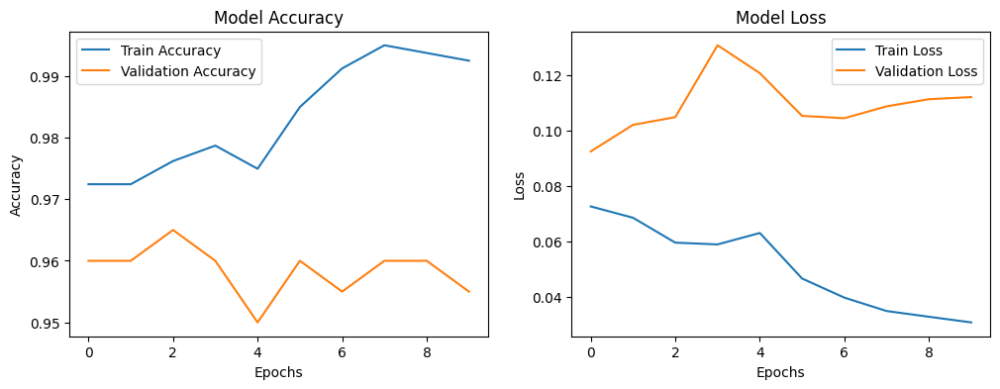

In [16]:
def plot_training_history(history):
    plt.figure(figsize=(12, 4))

    # Accuracy plot
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # Loss plot
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()

history = model.fit(X_train, y_train, epochs=10, batch_size=64, validation_data=(X_test, y_test))

# Assuming 'history' is the output from model.fit()
plot_training_history(history)


7/7 ━━━━━━━━━━━━━━━━━━━━ 4s 518ms/step


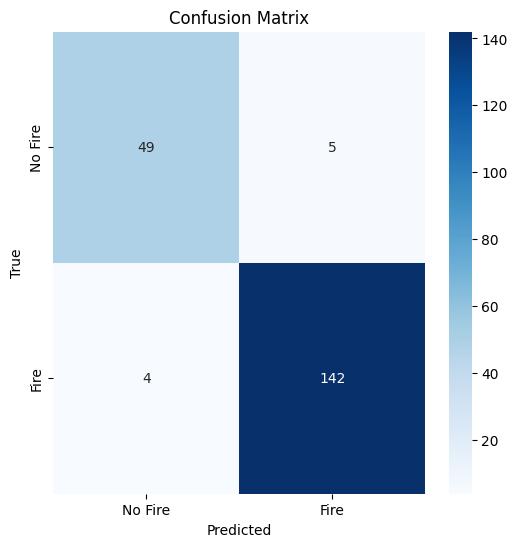

In [17]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

def plot_confusion_matrix(y_true, y_pred, labels=['No Fire', 'Fire']):
    conf_matrix = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()

# Assuming 'y_pred' and 'y_true' are your test predictions and true labels
y_pred = np.argmax(model.predict(X_test), axis=1)
y_true = np.argmax(y_test, axis=1)
plot_confusion_matrix(y_true, y_pred)


7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step


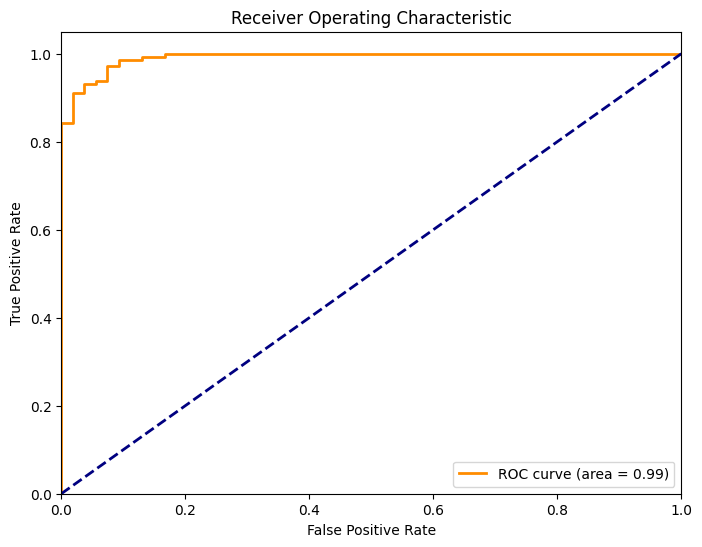

In [18]:
from sklearn.metrics import roc_curve, auc

def plot_roc_curve(y_true, y_pred):
    fpr, tpr, _ = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")
    plt.show()

# Generate ROC curve for fire detection
y_pred_proba = model.predict(X_test)[:, 1]  # Predicted probabilities for class "Fire"
y_true = np.argmax(y_test, axis=1)
plot_roc_curve(y_true, y_pred_proba)


7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 277ms/step


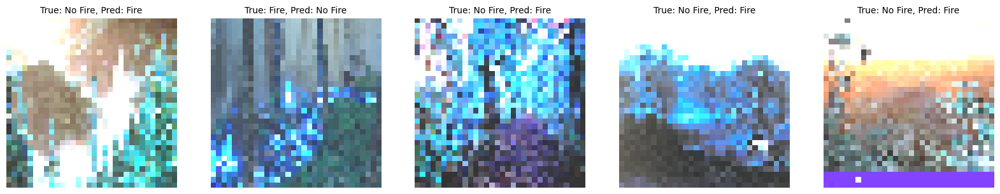

In [19]:
import random
import cv2
import matplotlib.pyplot as plt

# Function to visualize misclassified images with enhanced contrast
def visualize_misclassified_images(X, y_true, y_pred, num_samples=5):
    misclassified_indices = np.where(y_true != y_pred)[0]
    if len(misclassified_indices) > num_samples:
        misclassified_indices = np.random.choice(misclassified_indices, num_samples, replace=False)

    fig, axes = plt.subplots(1, num_samples, figsize=(20, 5))  # Increase the figure size
    for i, idx in enumerate(misclassified_indices):
        # Apply contrast enhancement
        low_res_image = X[idx] * 255
        low_res_image = cv2.convertScaleAbs(low_res_image, alpha=1.5, beta=50)  # Alpha: Contrast, Beta: Brightness

        axes[i].imshow(low_res_image.astype('uint8'))
        true_label = 'Fire' if y_true[idx] == 1 else 'No Fire'
        pred_label = 'Fire' if y_pred[idx] == 1 else 'No Fire'

        # Set the title with the true and predicted labels
        axes[i].set_title(f"True: {true_label}, Pred: {pred_label}", fontsize=10)
        axes[i].axis('off')

    plt.show()

# Example: Visualizing 5 misclassified images with enhanced contrast
y_pred = np.argmax(model.predict(X_test), axis=1)  # Predicted labels
y_true = np.argmax(y_test, axis=1)  # True labels

visualize_misclassified_images(X_test, y_true, y_pred, num_samples=5)


In [20]:
print(f"X_test shape: {X_test.shape}")
print(f"y_test shape: {y_test.shape}")


X_test shape: (200, 32, 32, 3)
y_test shape: (200, 2)


In [21]:
# Evaluate the model
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Save the model weights
model.save_weights('/content/drive/MyDrive/FireDetectionModel/vgg16_fire_detection.weights.h5')

7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 280ms/step - accuracy: 0.9634 - loss: 0.0867
Test Accuracy: 95.50%


BOth image and video
video code to be updated next week

Enter '1' to upload an image or '2' to upload a video: 2
Please upload a video file:


Saving 855196-hd_1920_1080_25fps.mp4 to 855196-hd_1920_1080_25fps (1).mp4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step



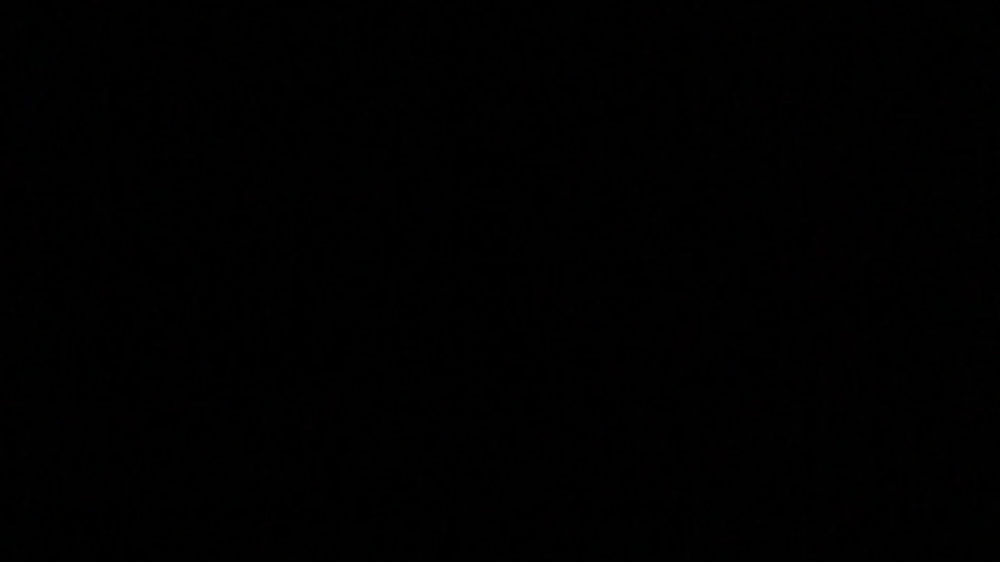

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step



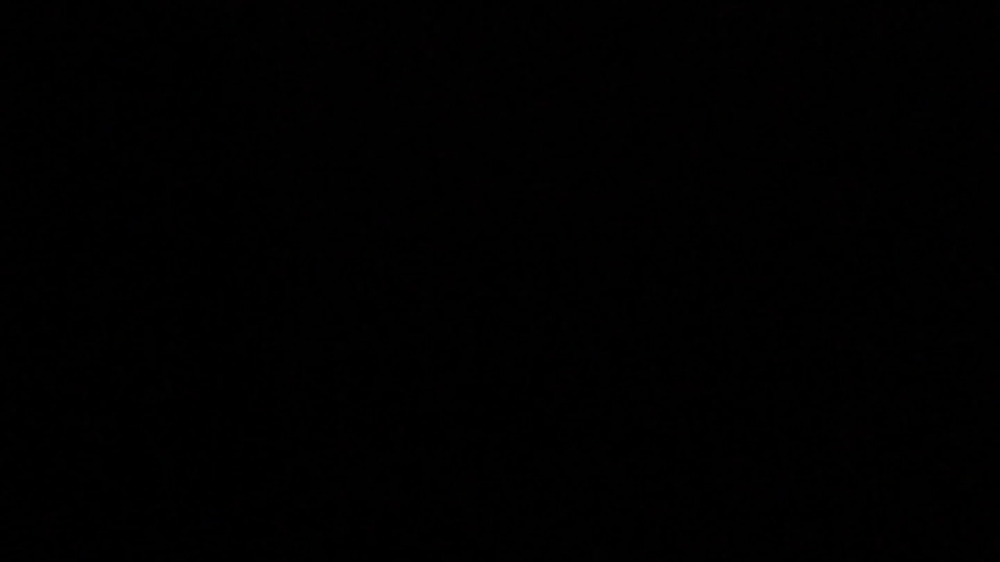

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step



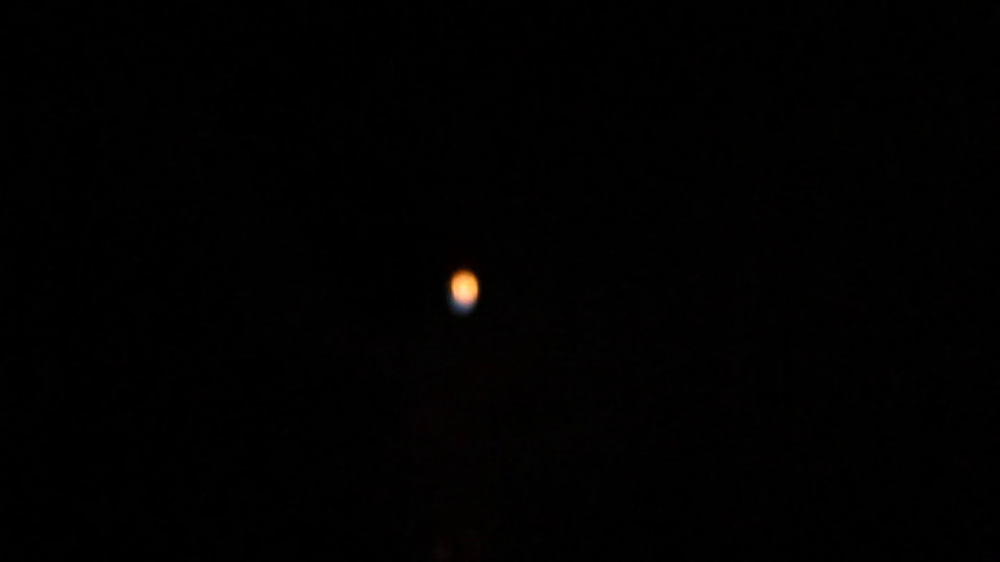

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step



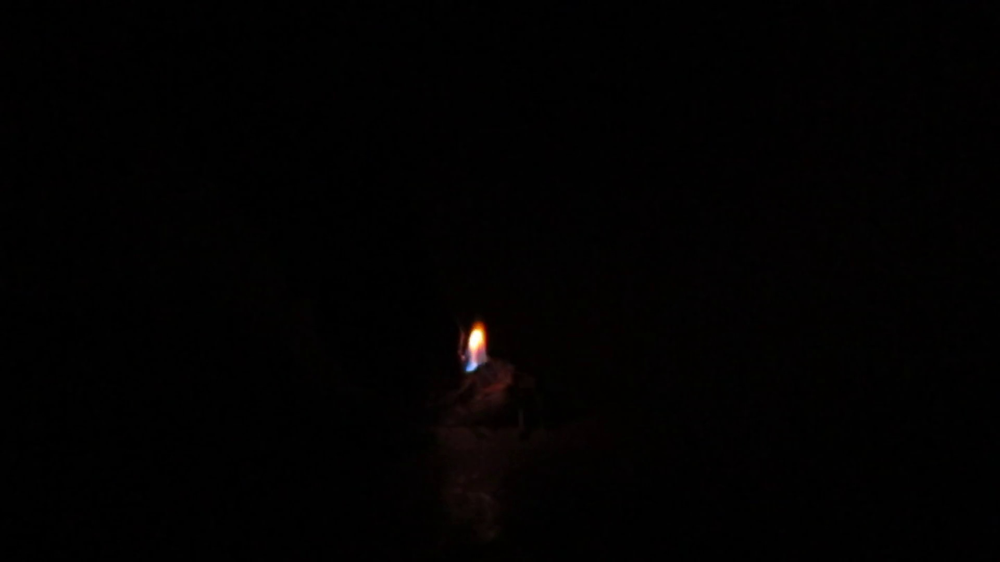

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step



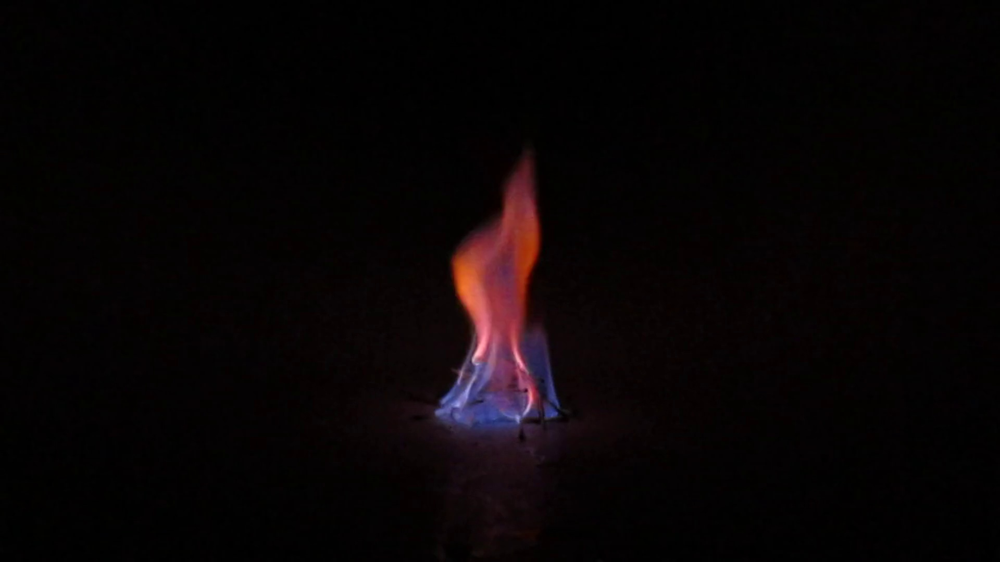

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step



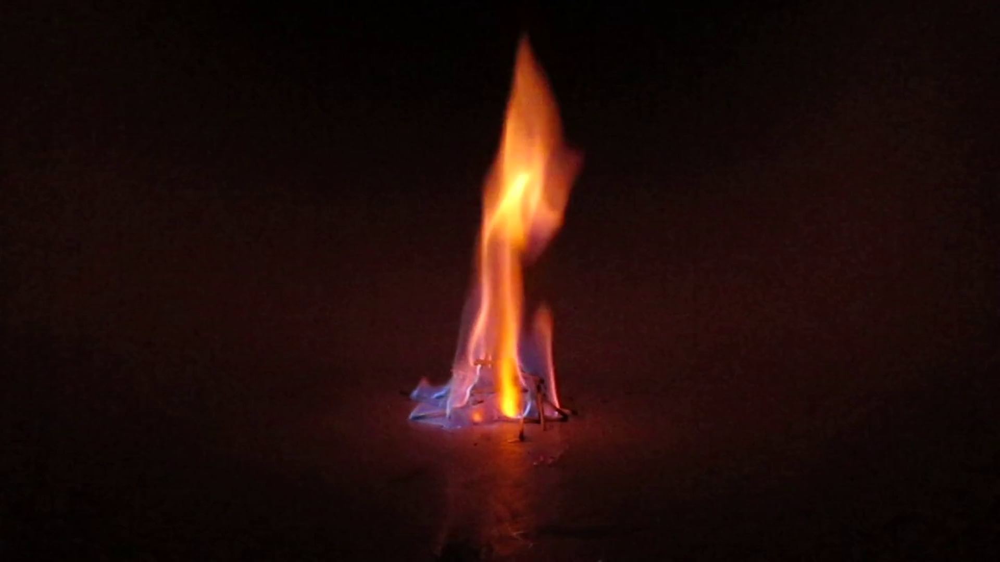

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step



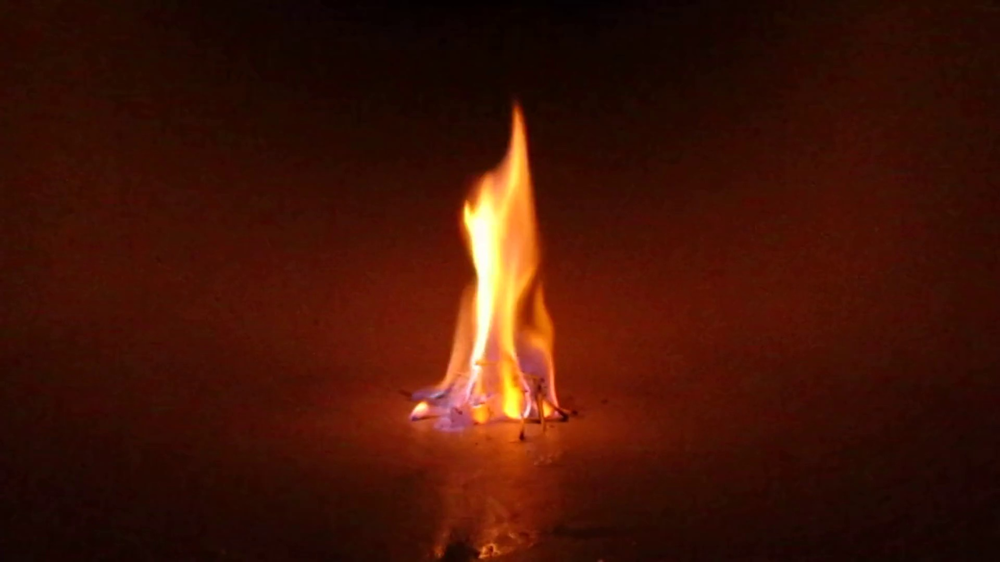

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step



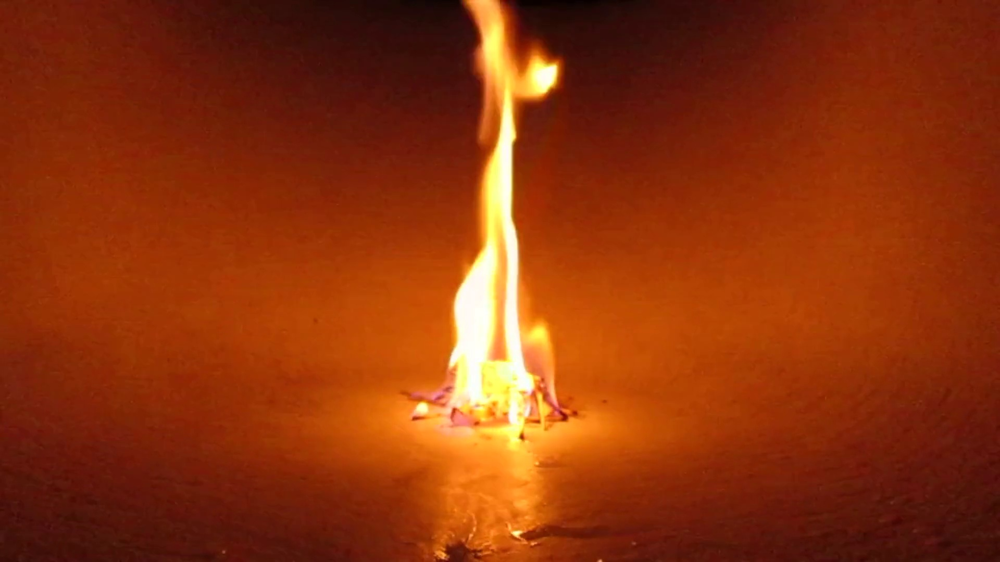

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



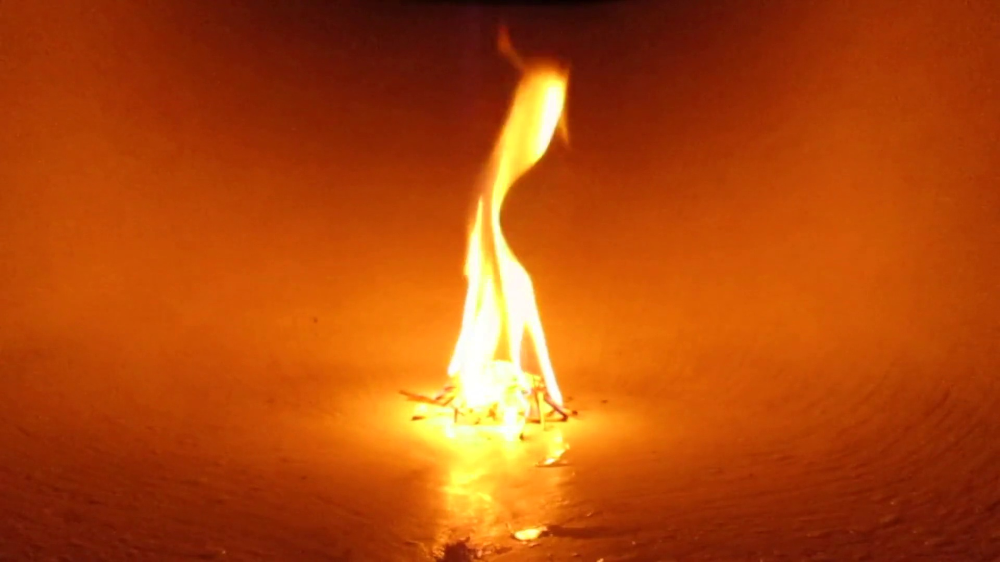

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step



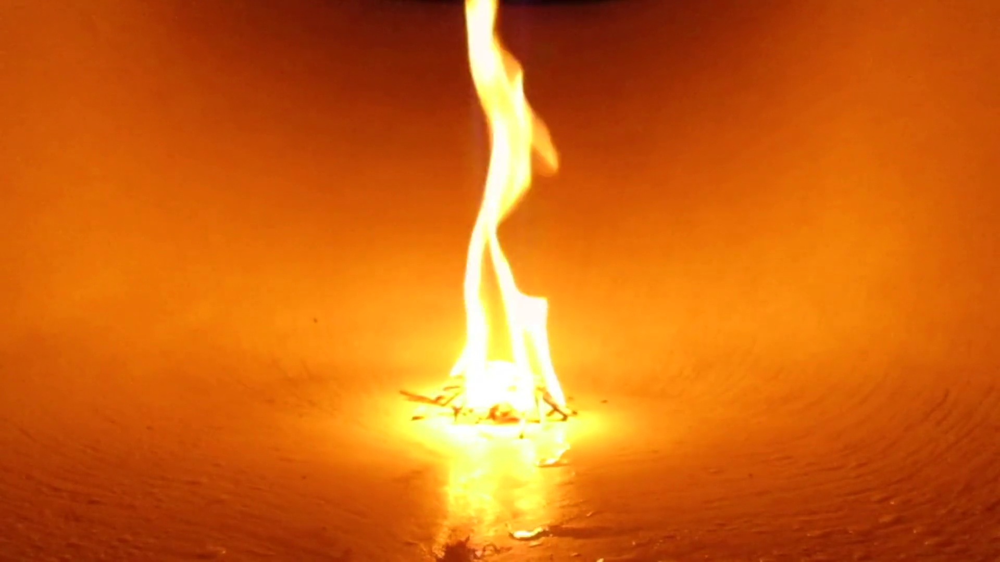

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step



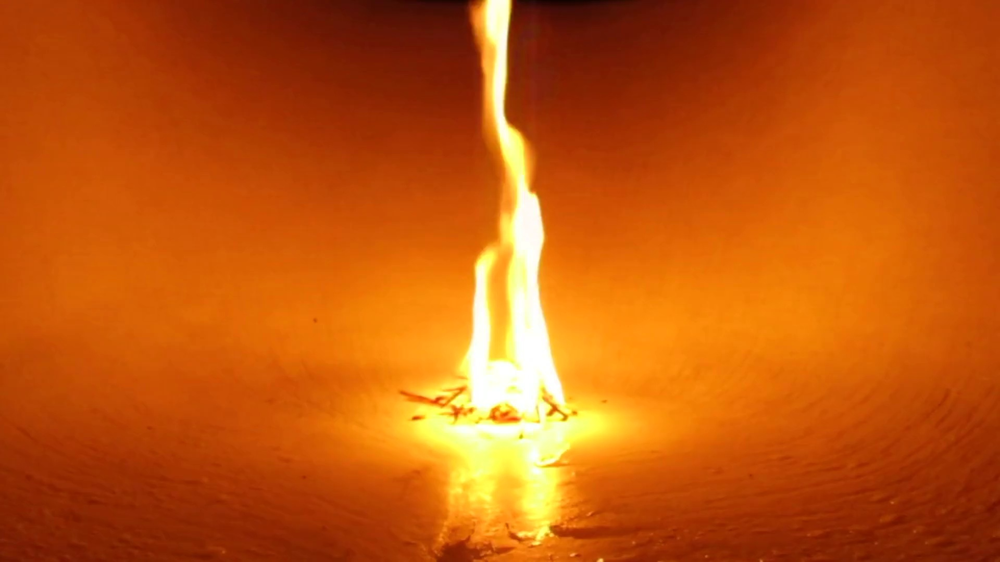

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step



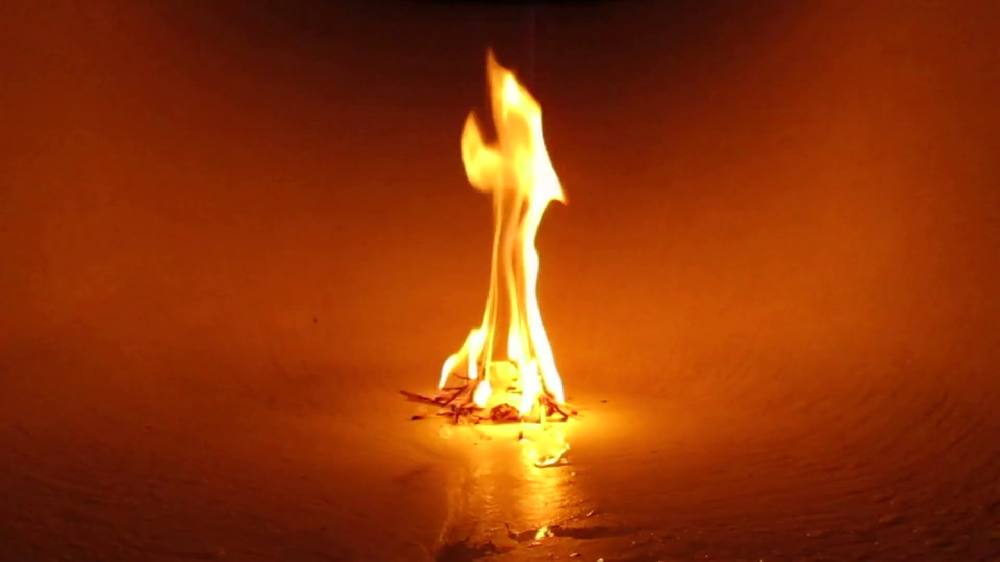

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step



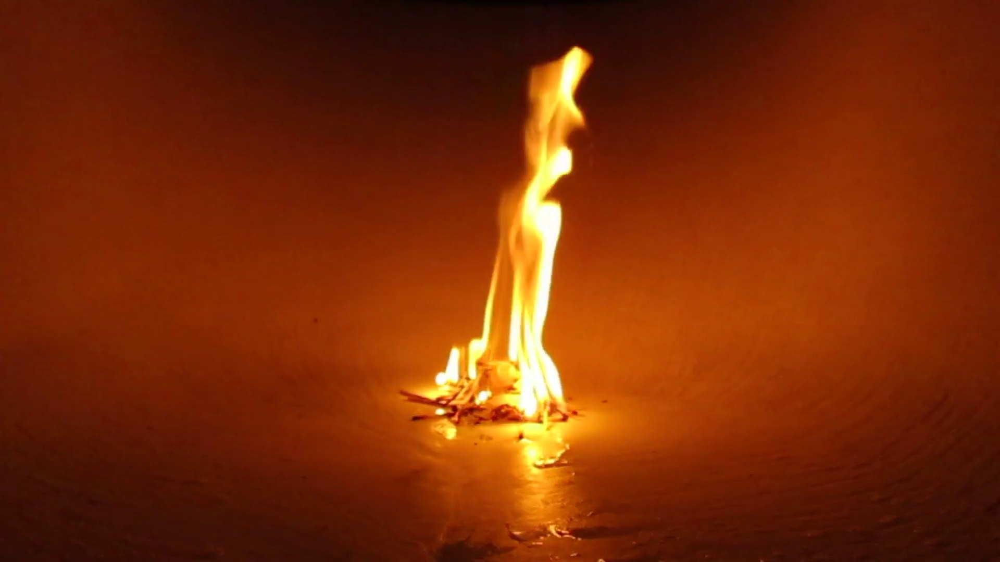

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step



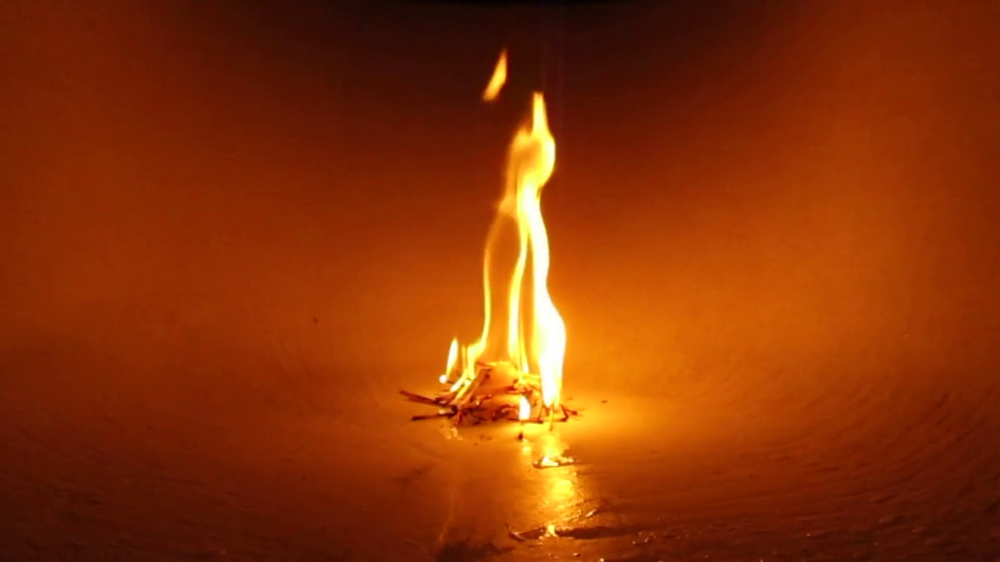

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step



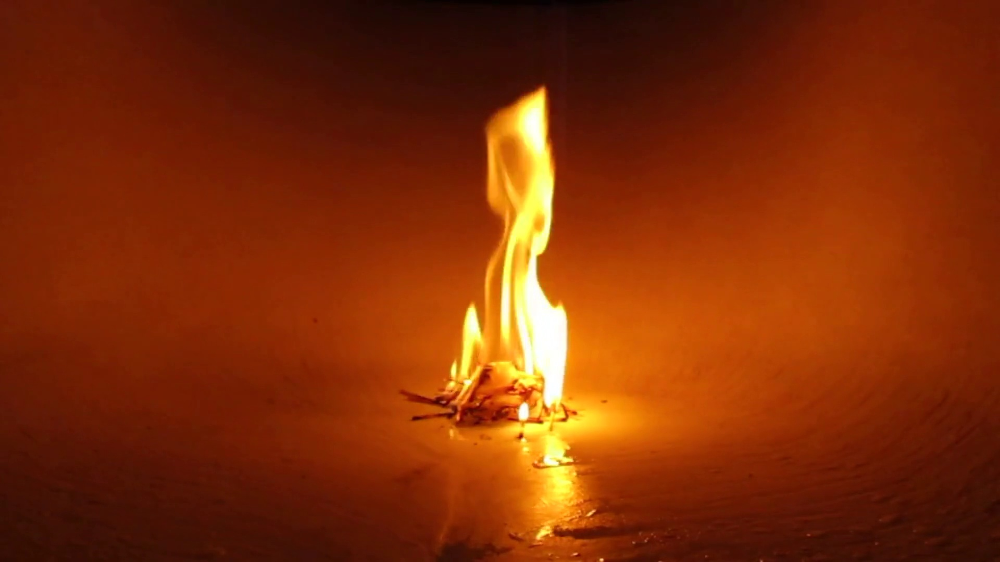

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step



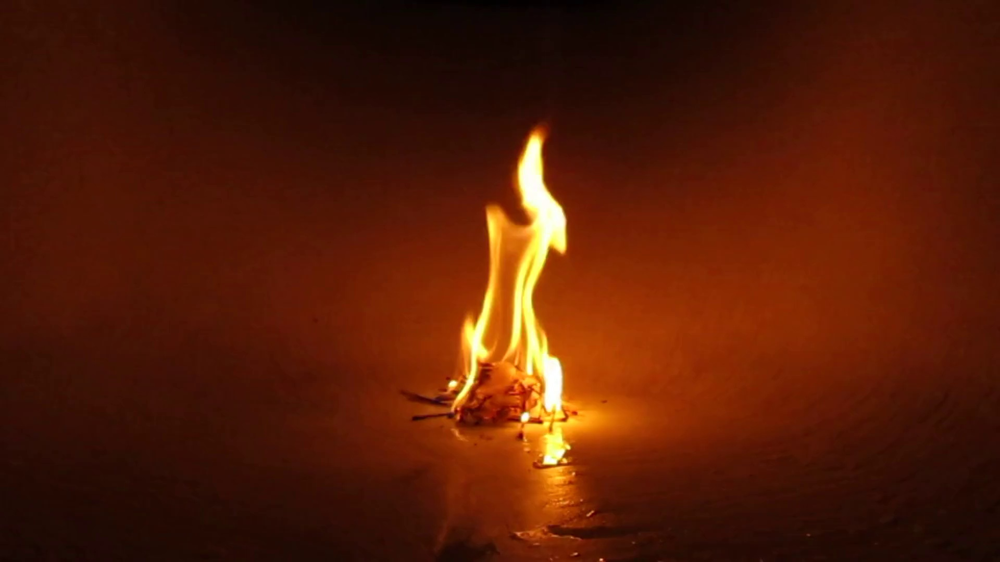

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step



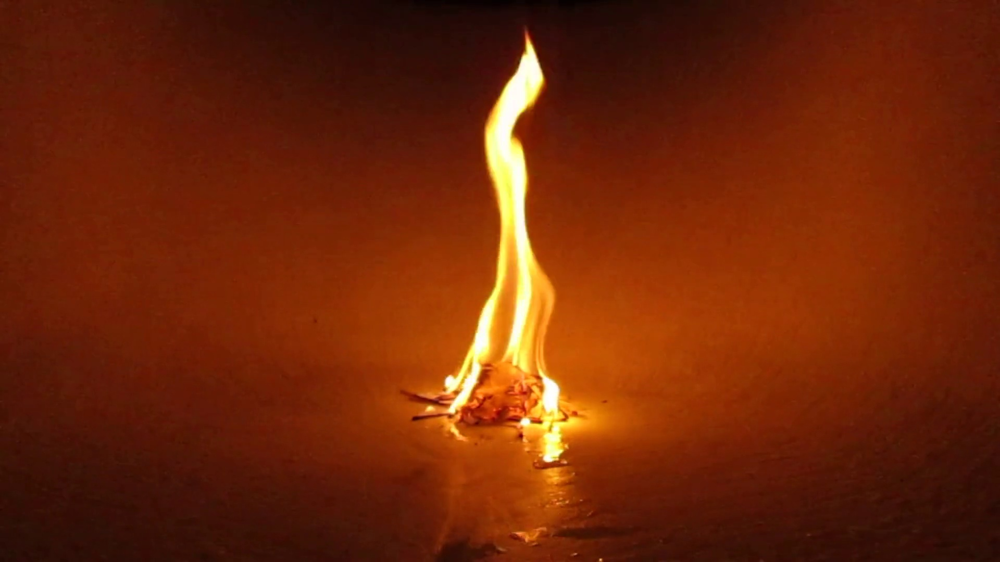

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step



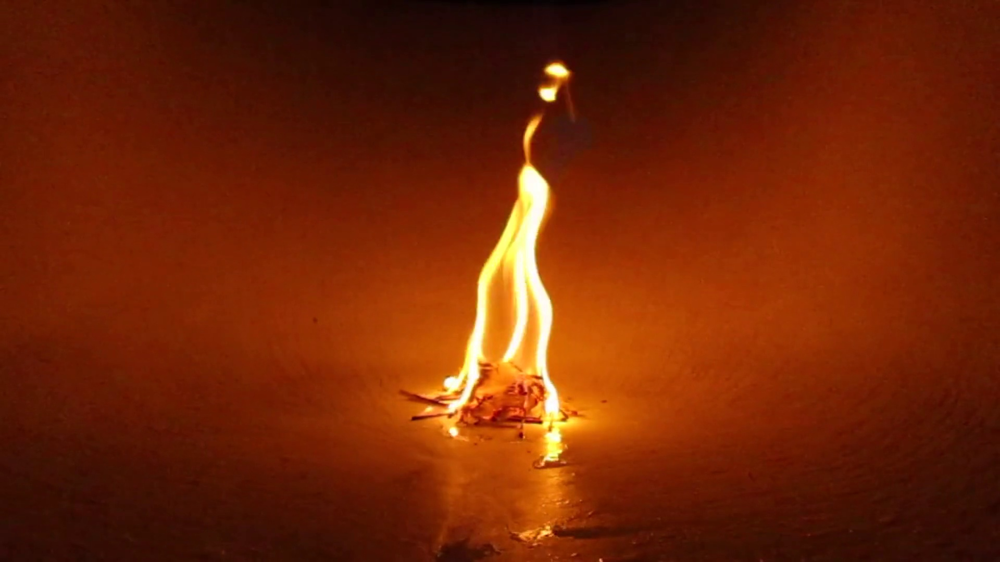

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step



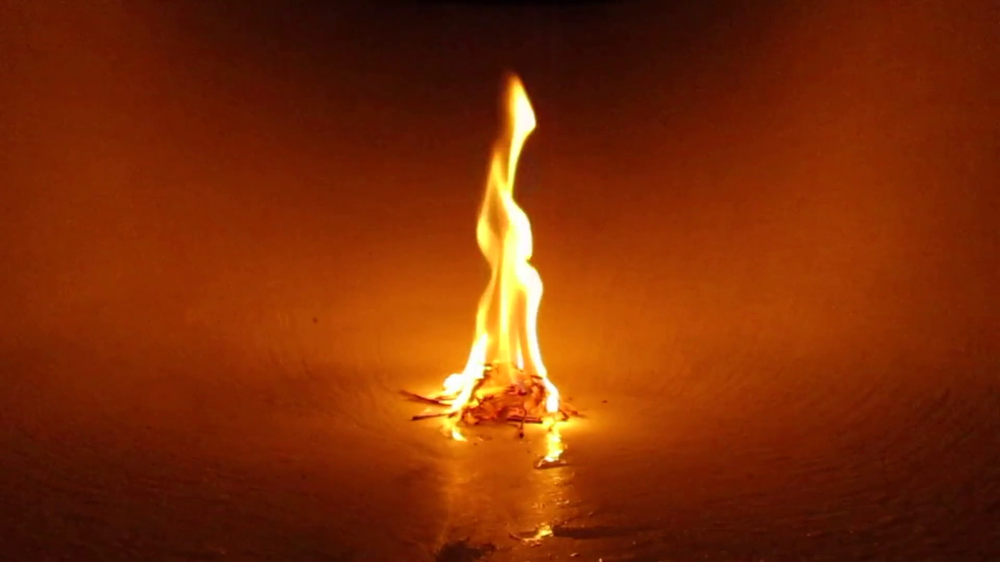

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step



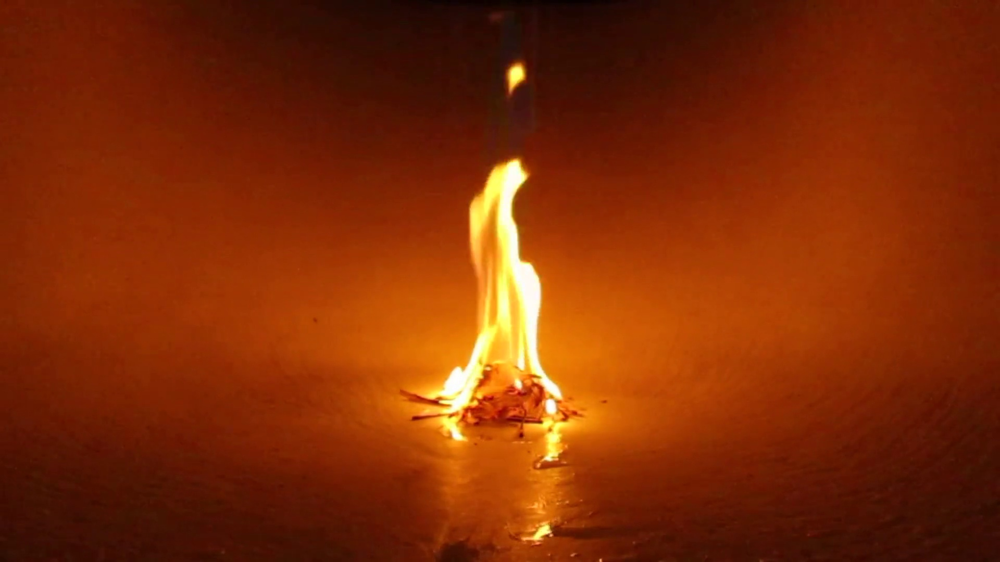

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step



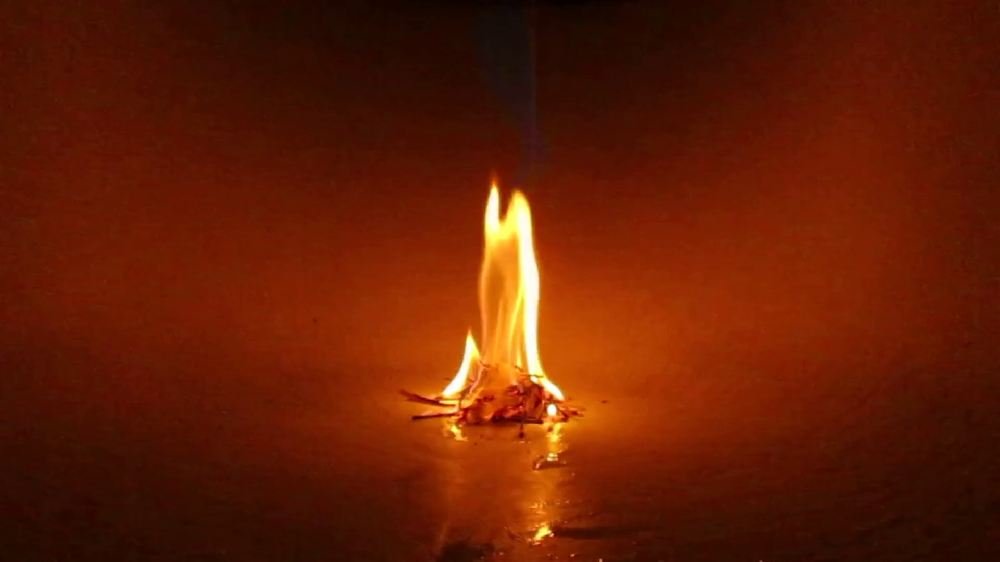

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step



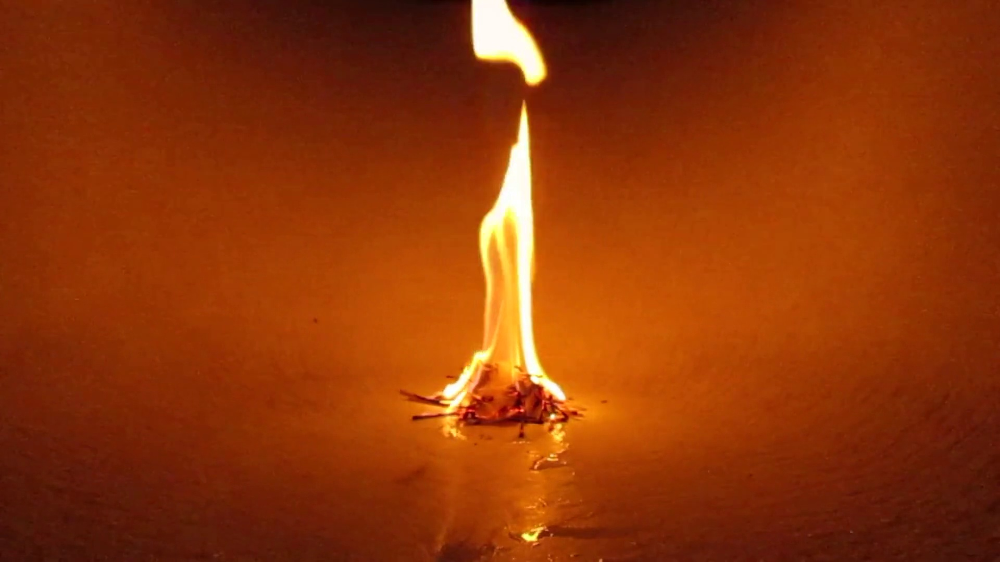

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step



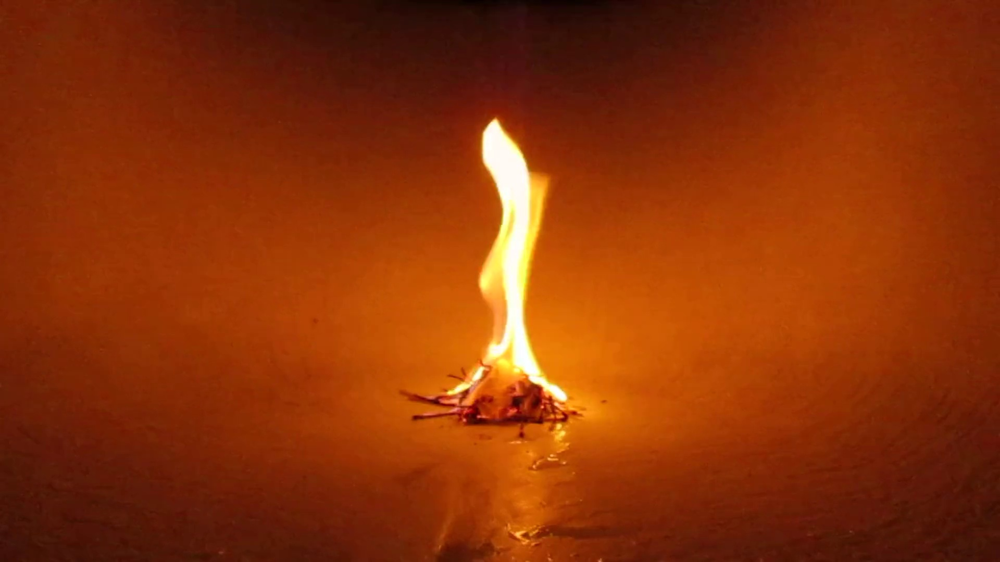

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step



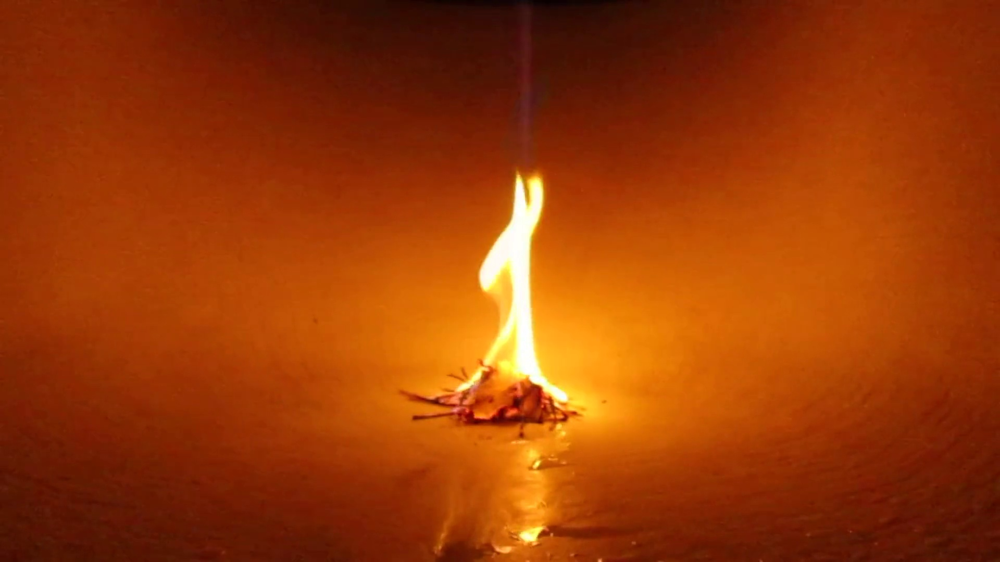

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step



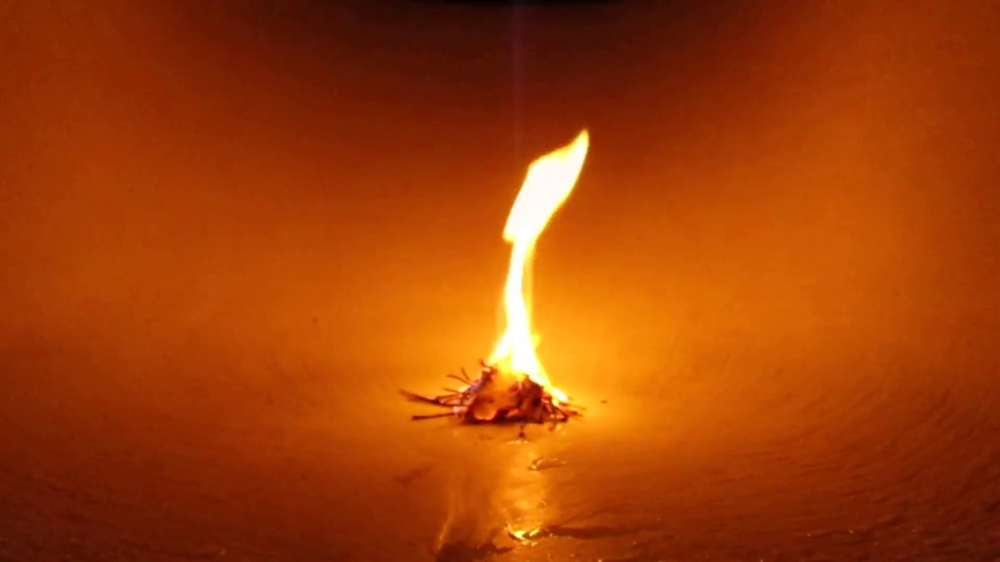

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step



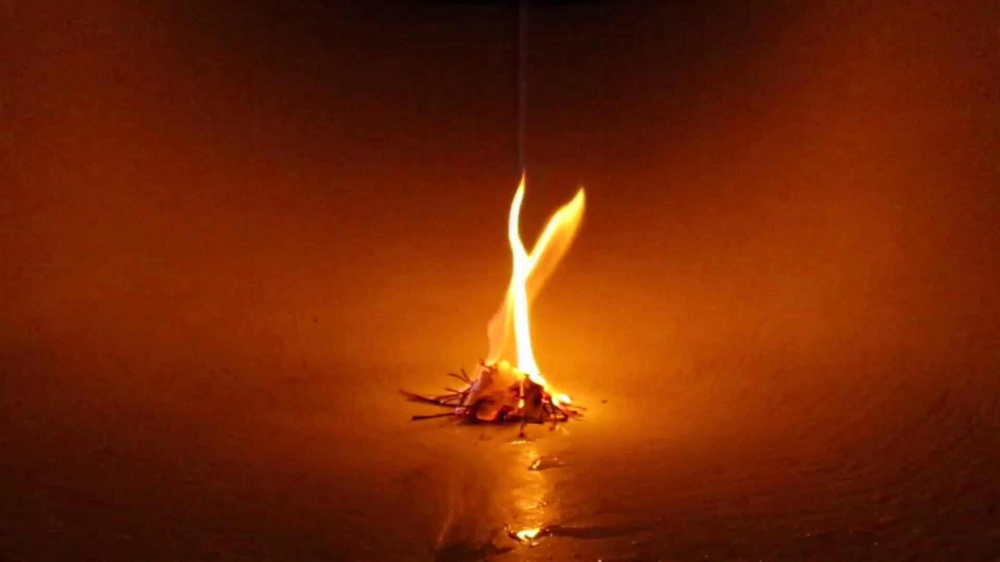

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step



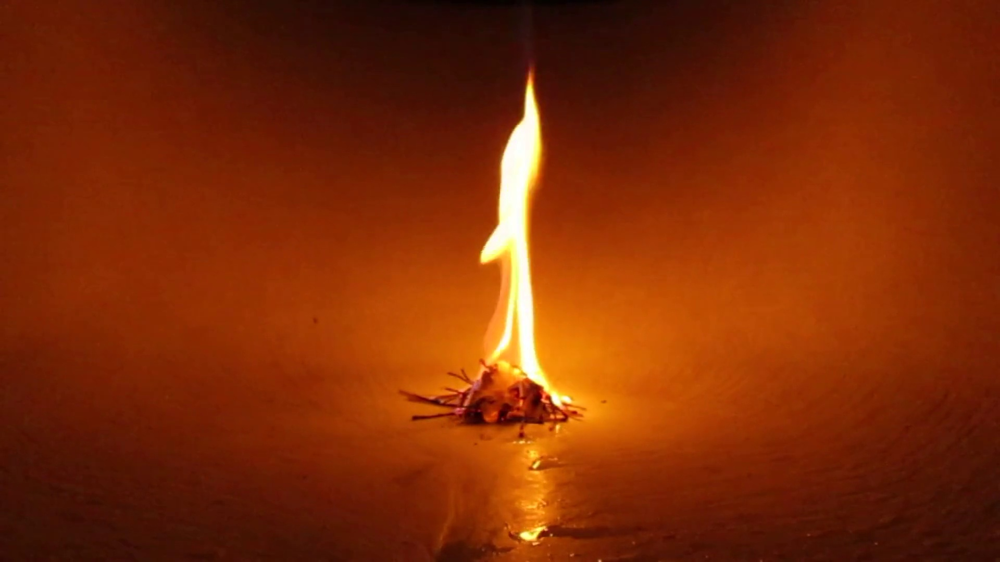

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step



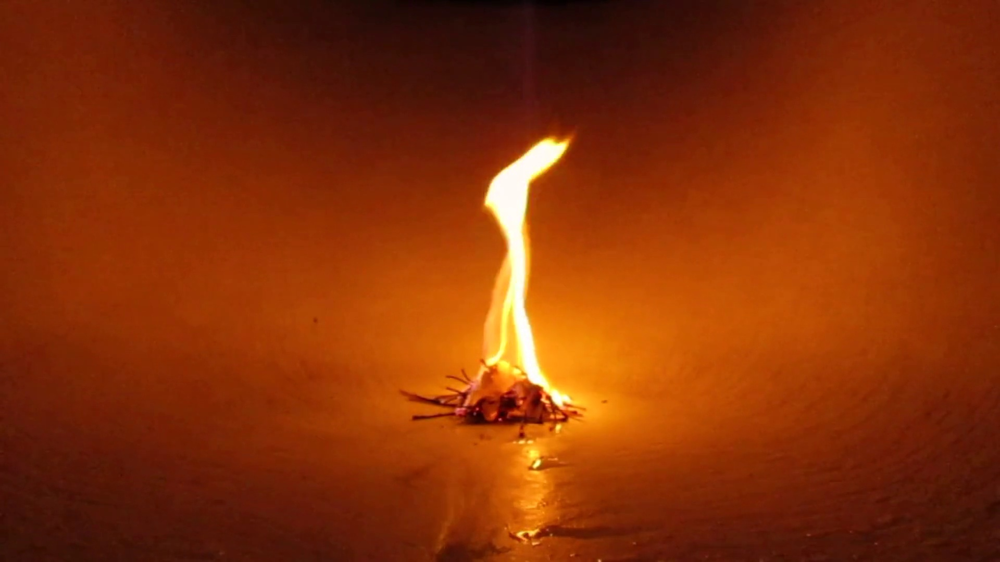

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step



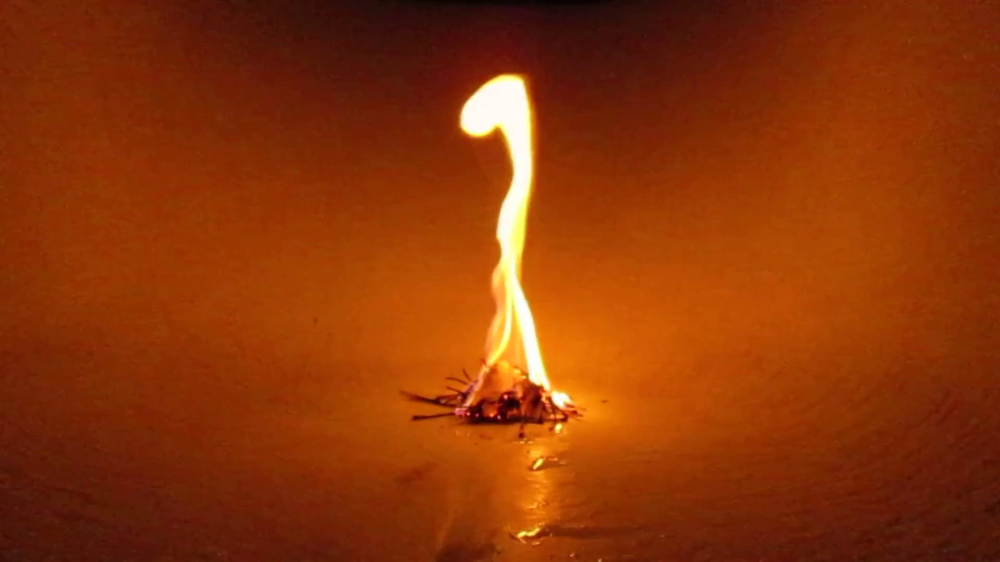

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step



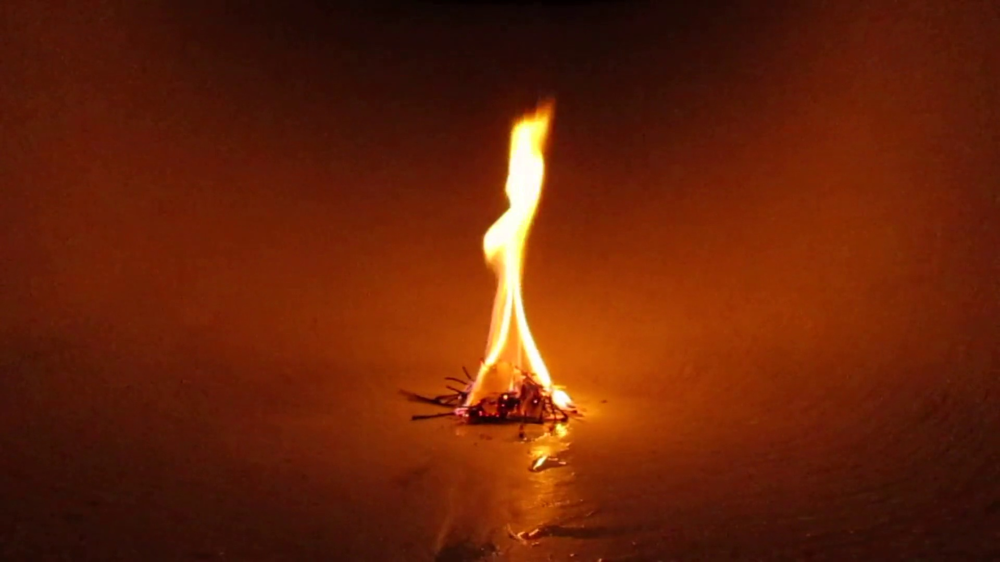

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step



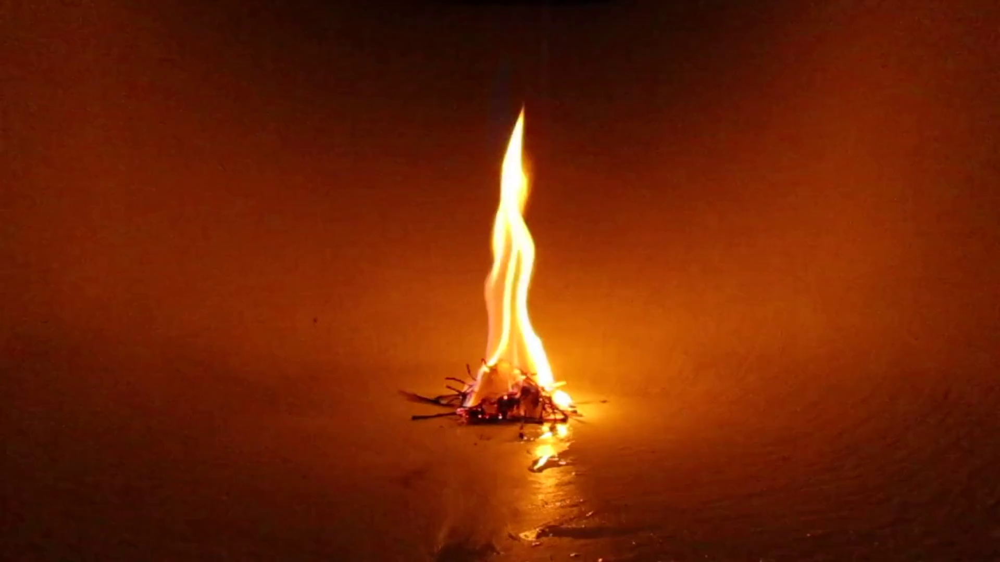

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step



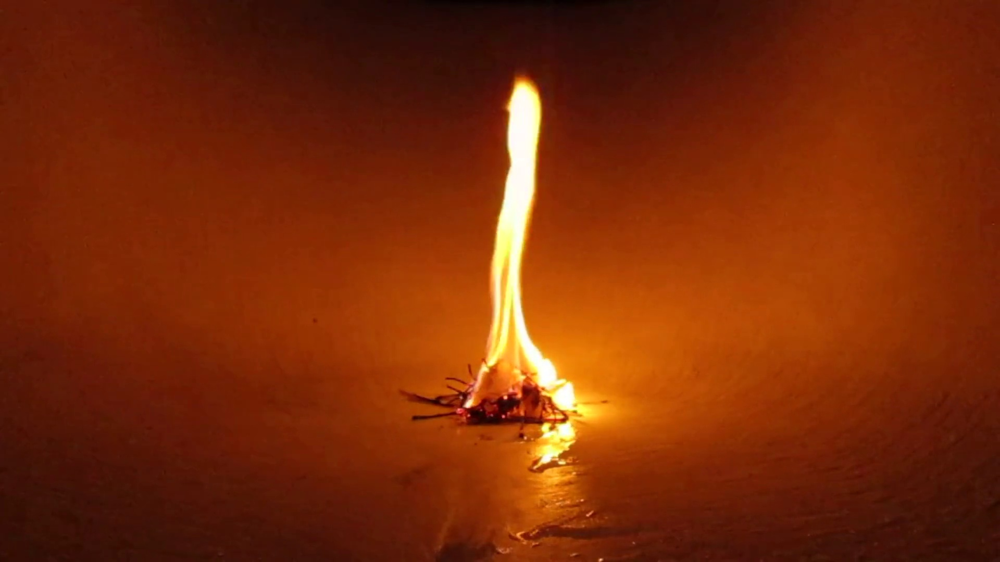

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



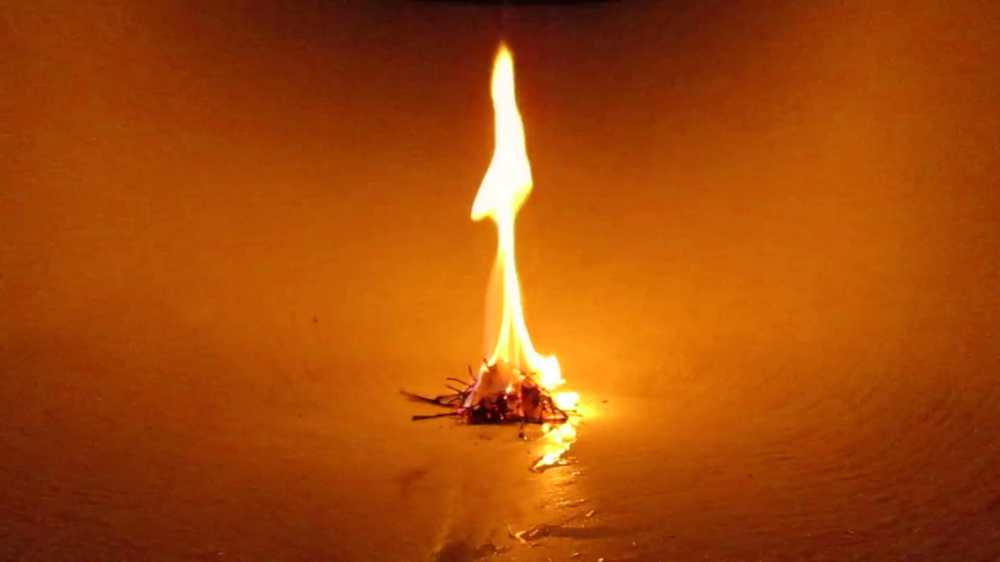

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step



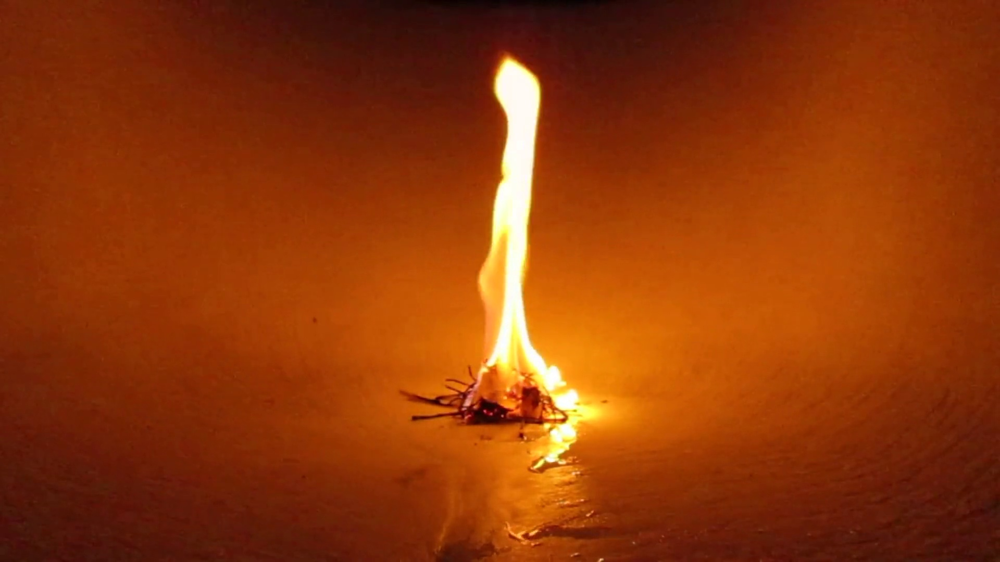

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



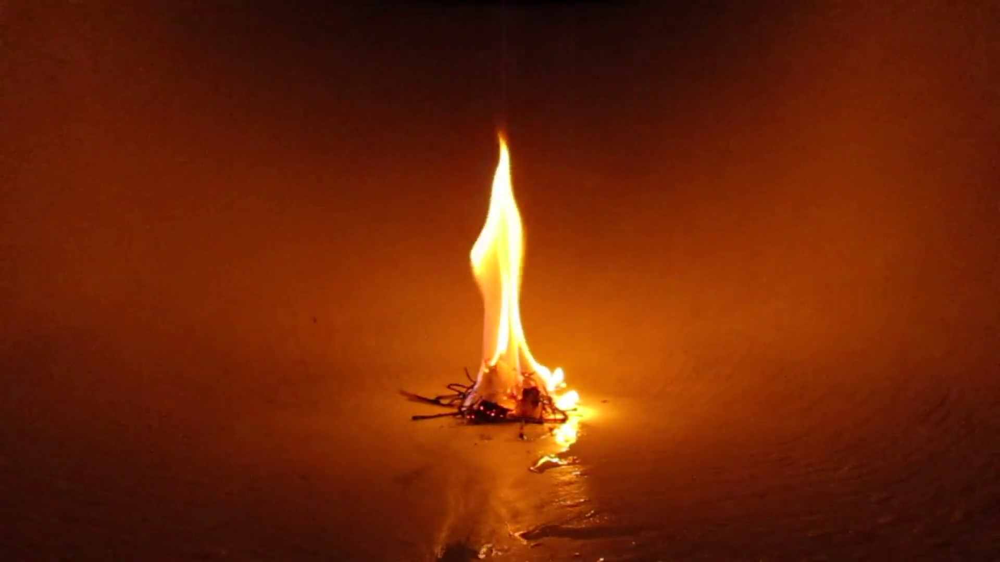

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step



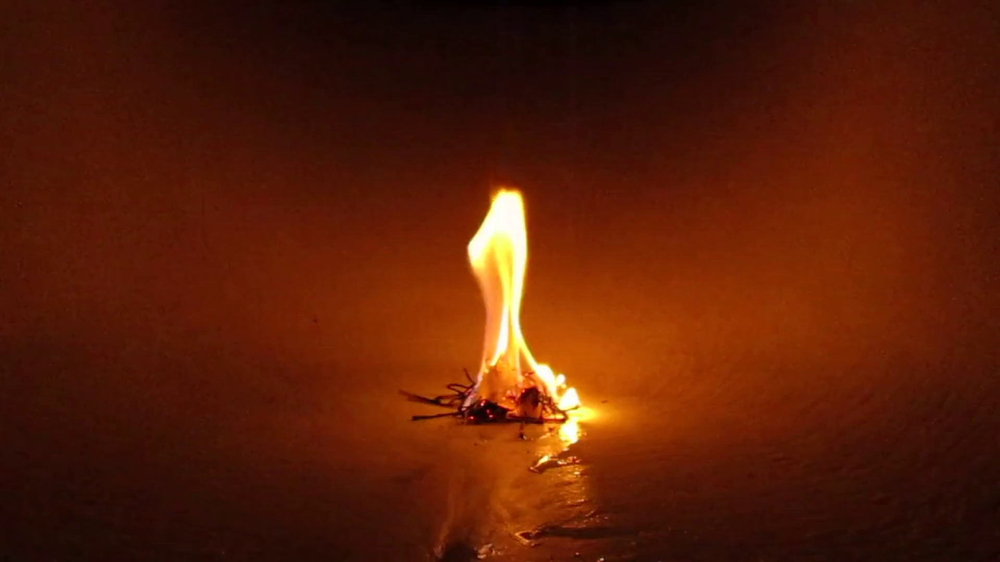

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step



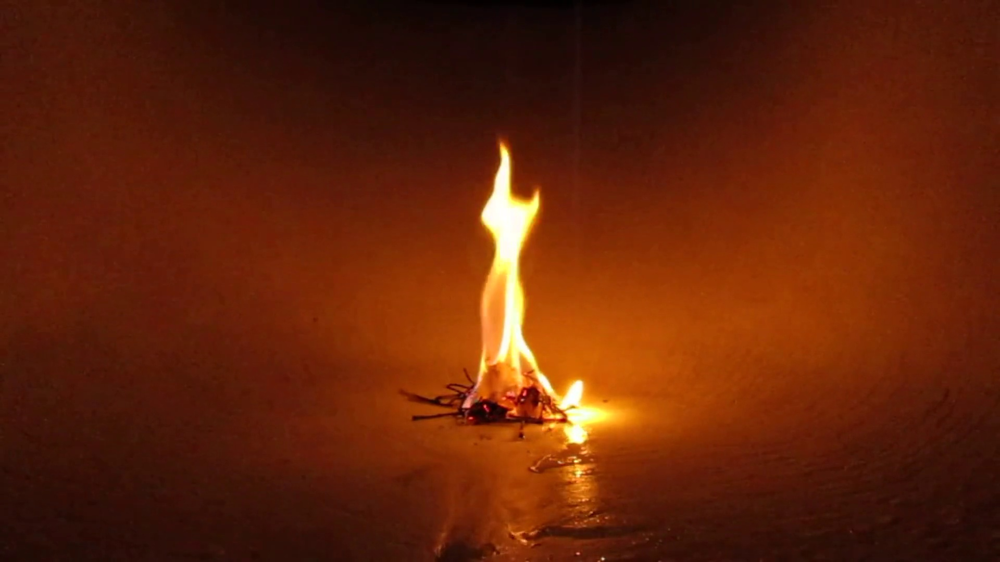

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step



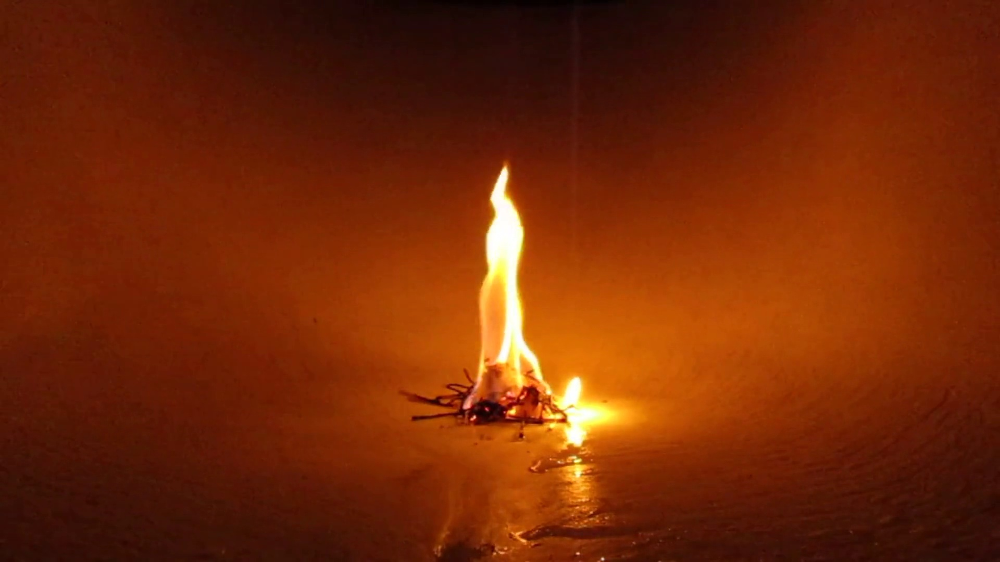

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step



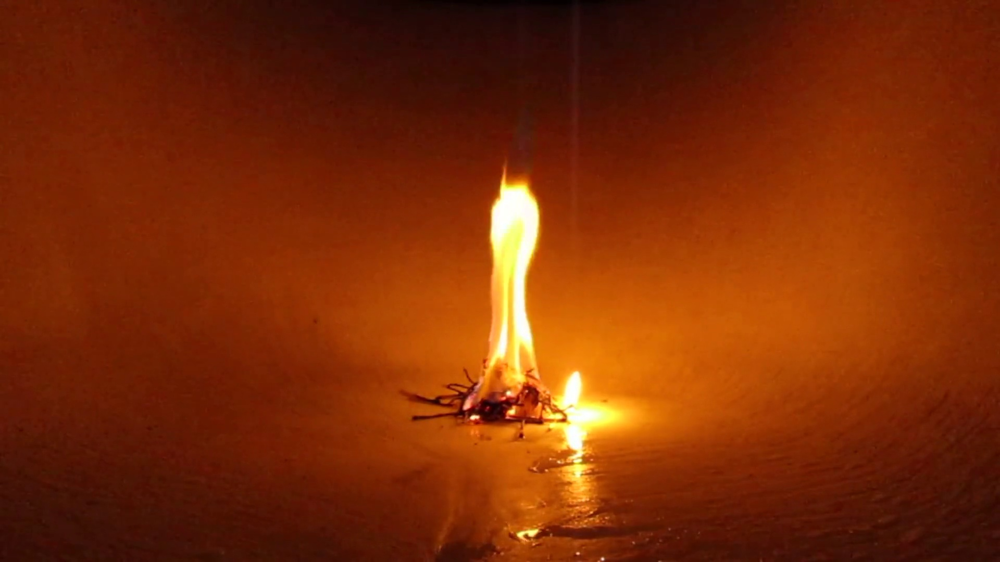

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step



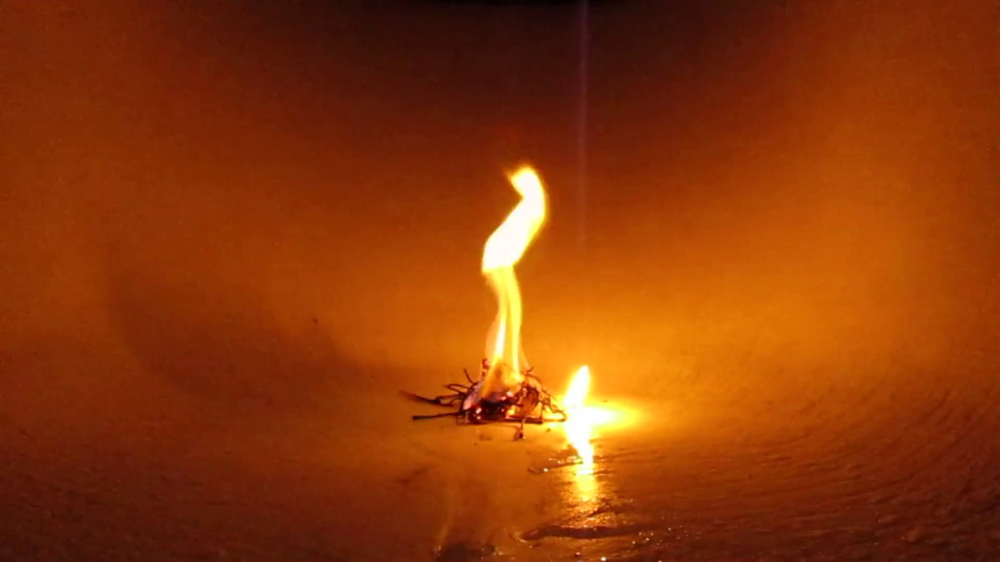

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step



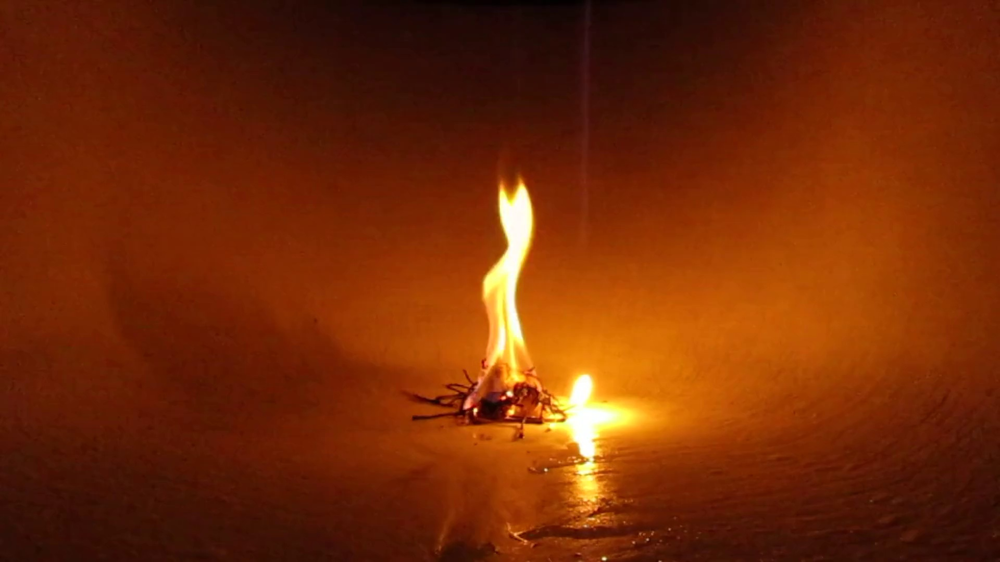

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step



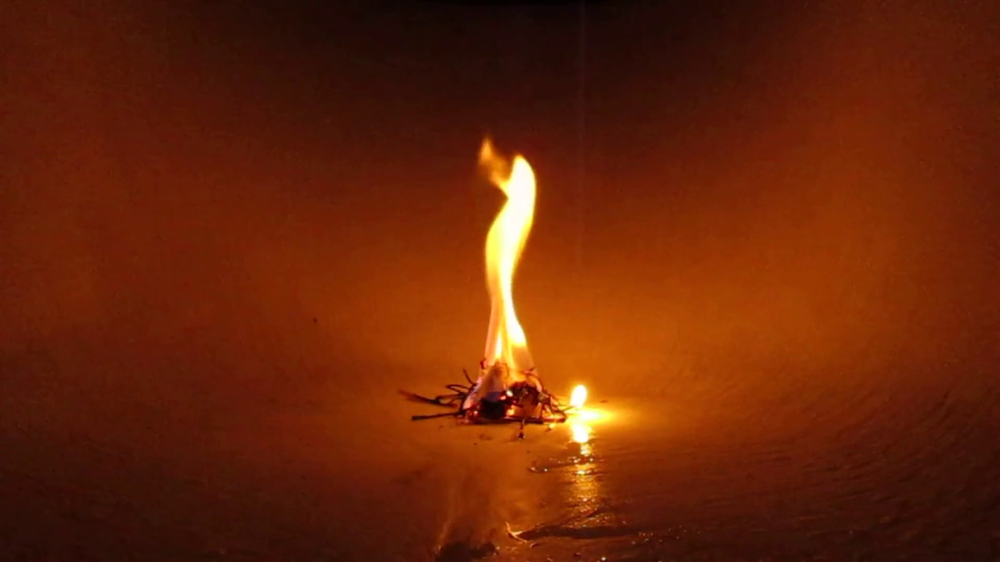

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step



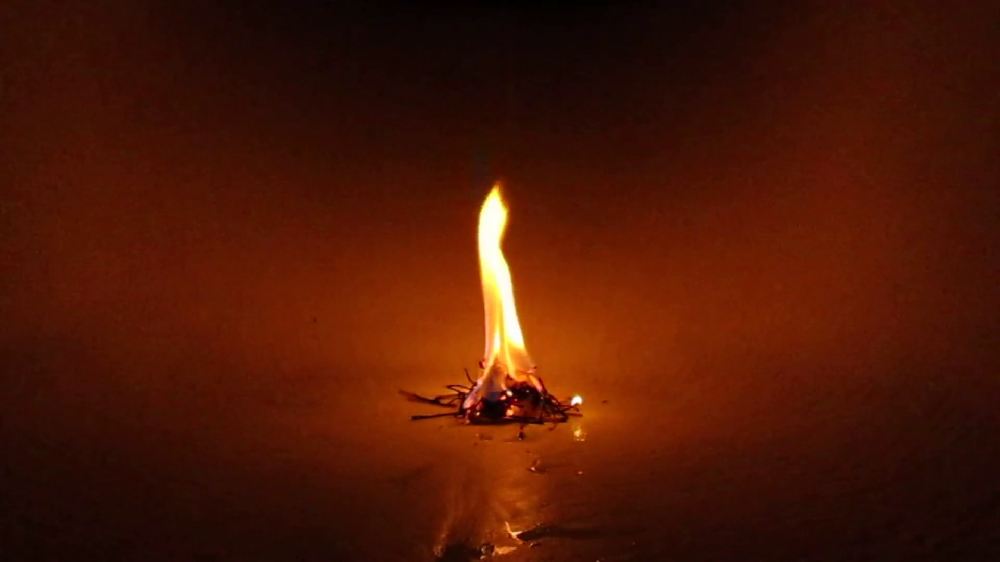

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step



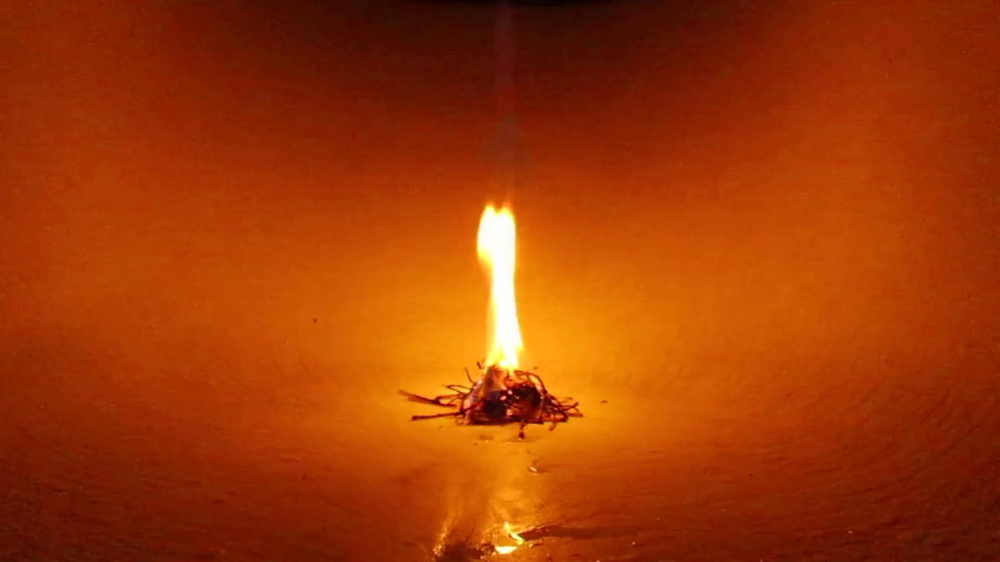

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step



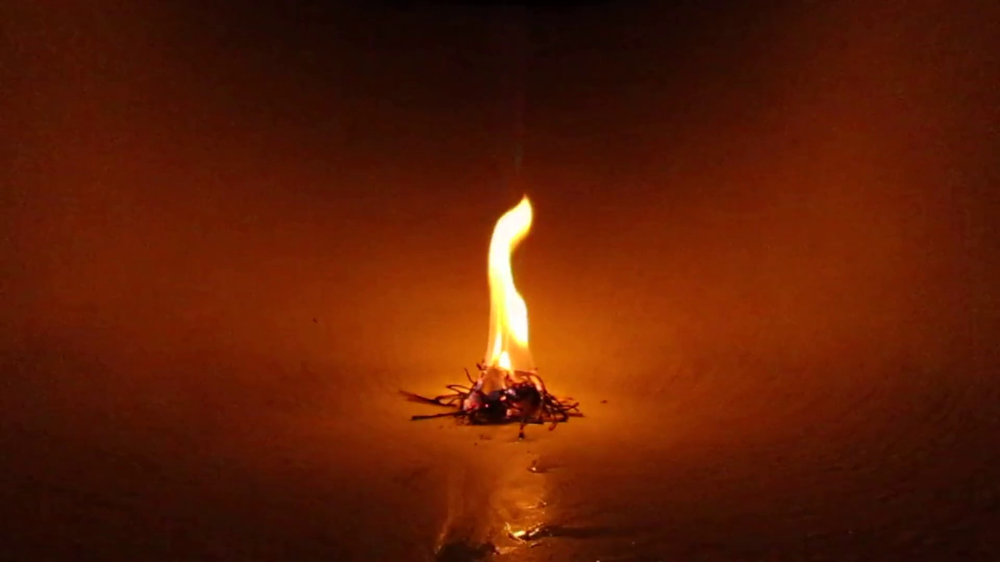

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step



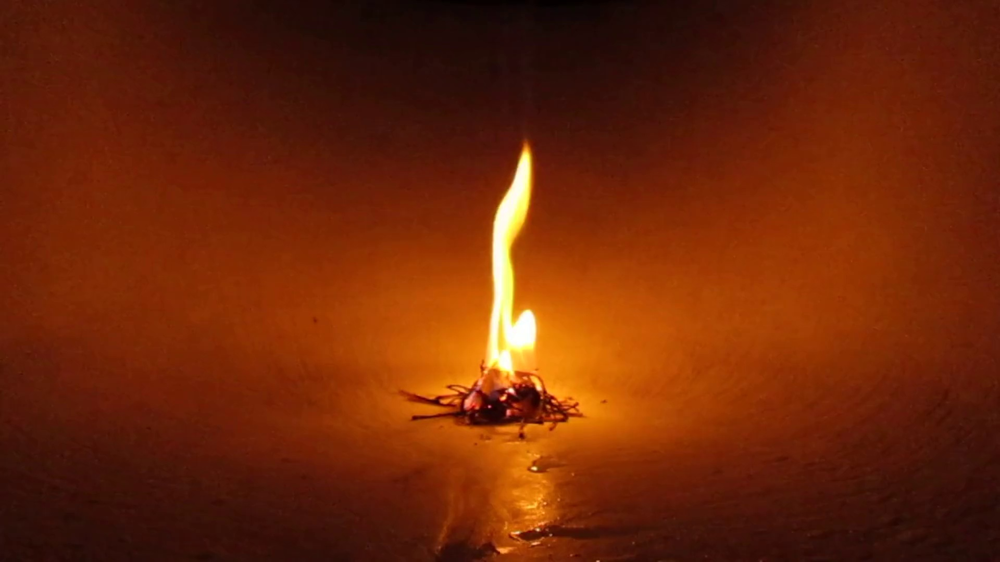

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step



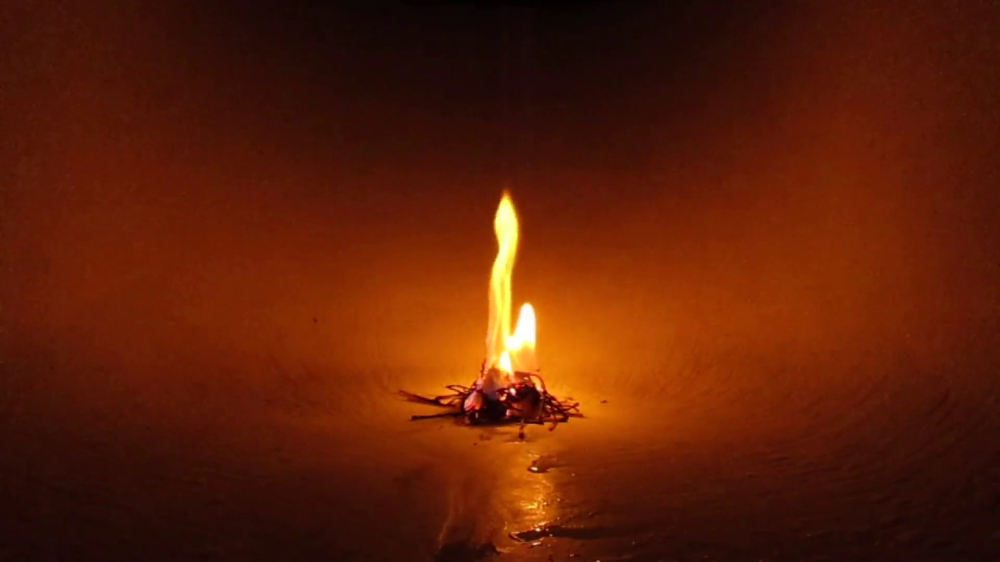

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step



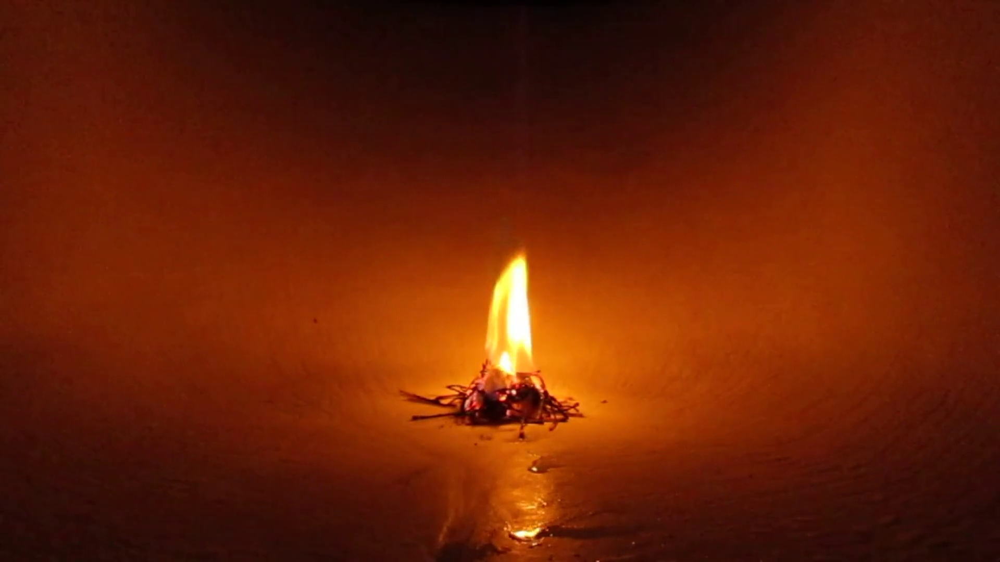

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step



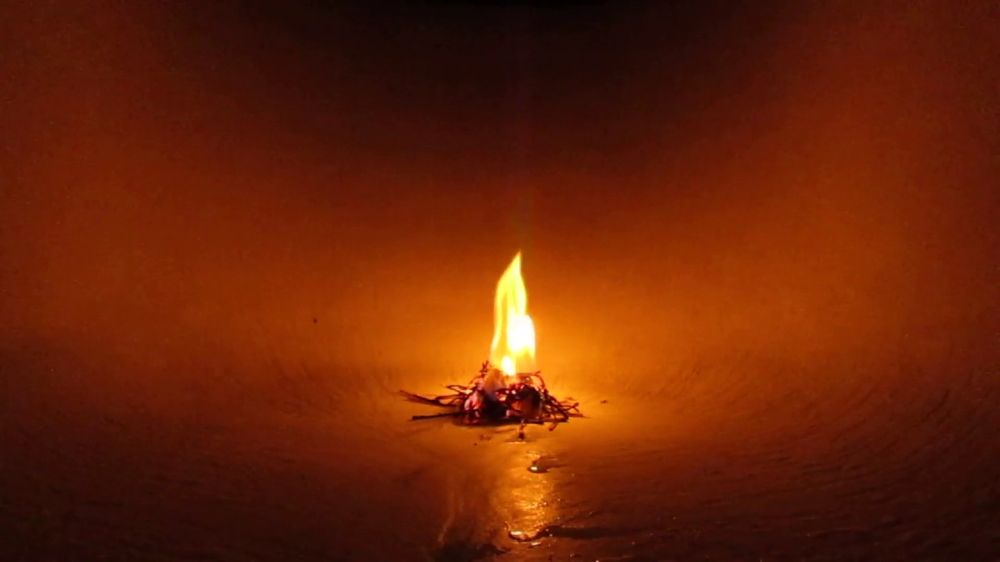

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step



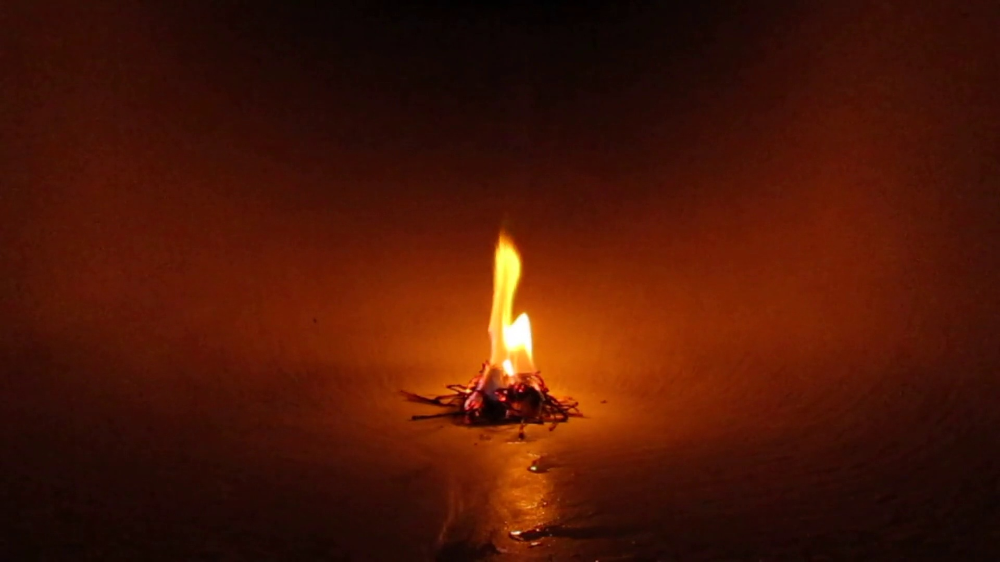

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



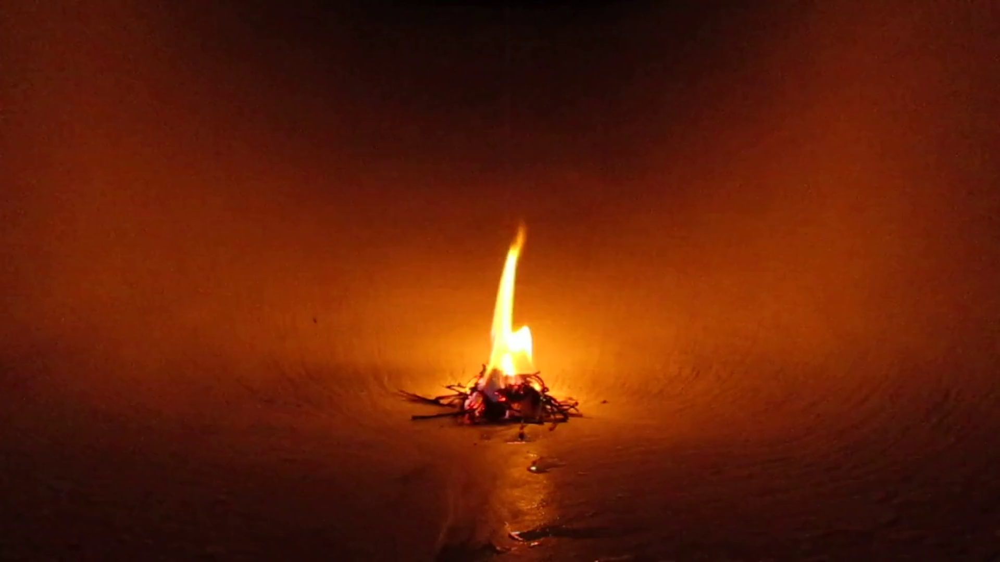

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step



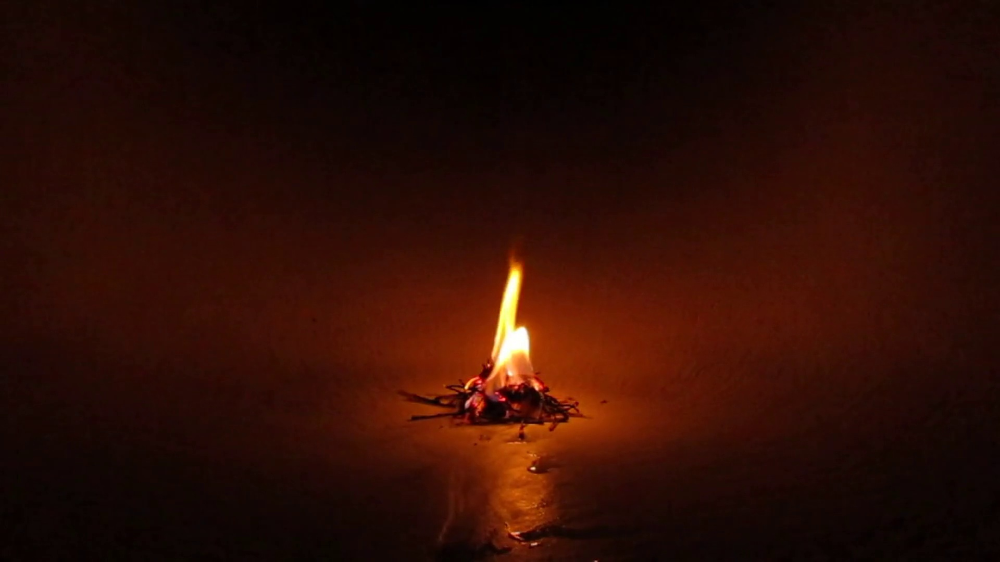

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step



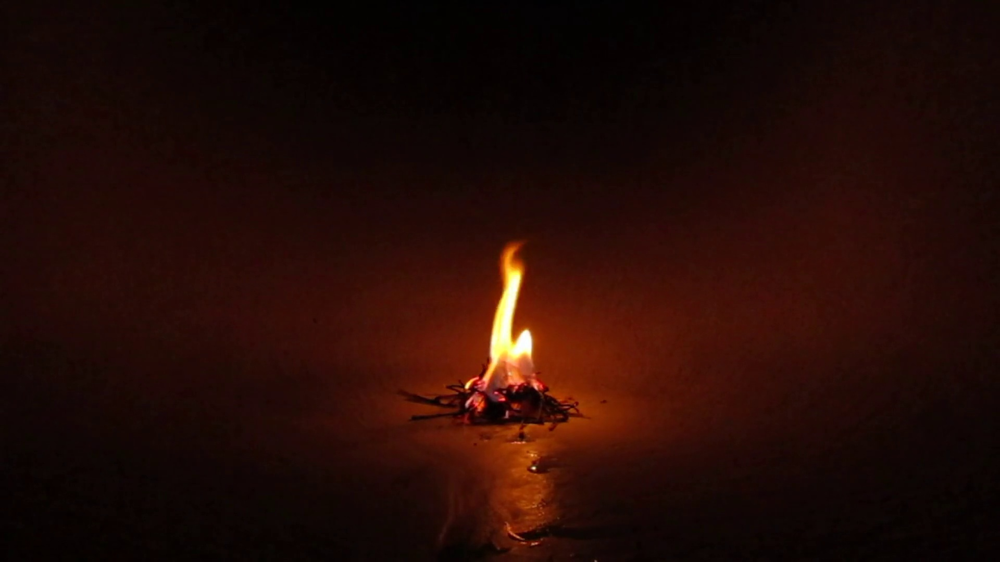

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step



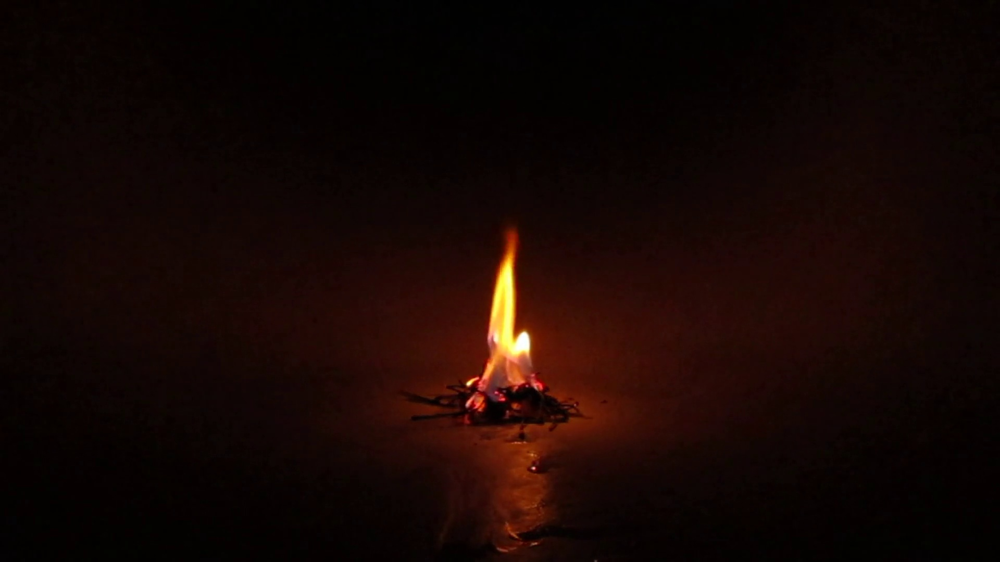

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step



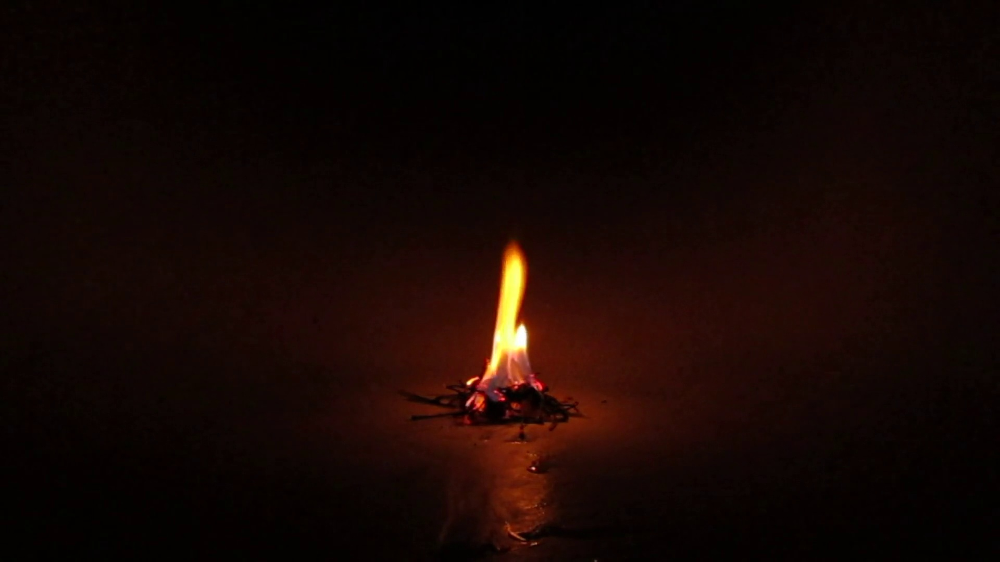

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step



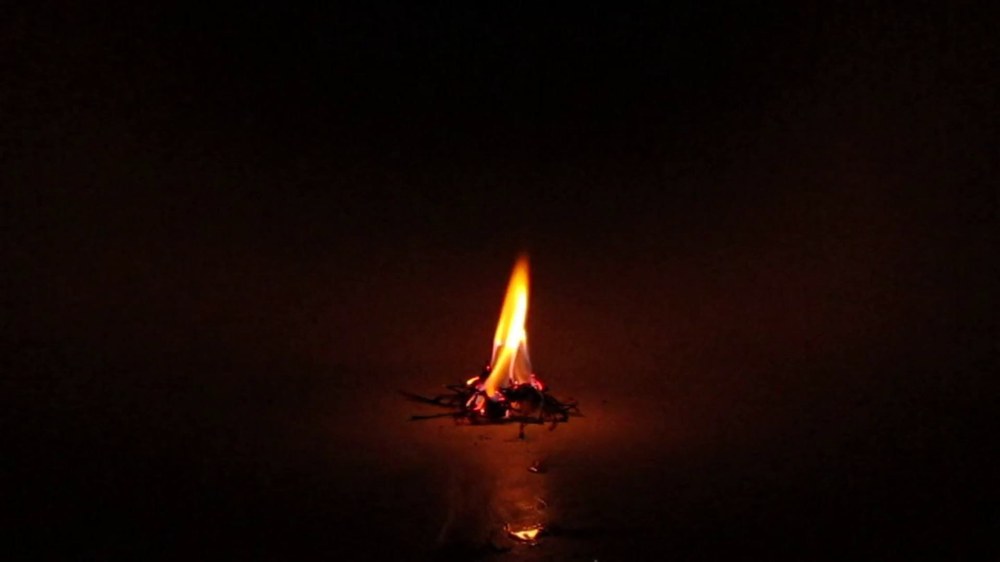

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step



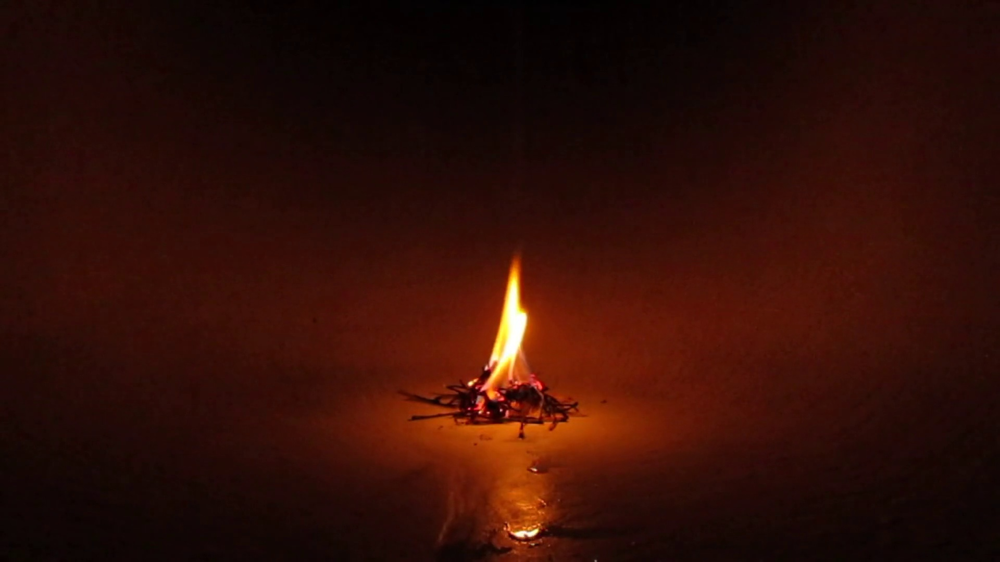

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step



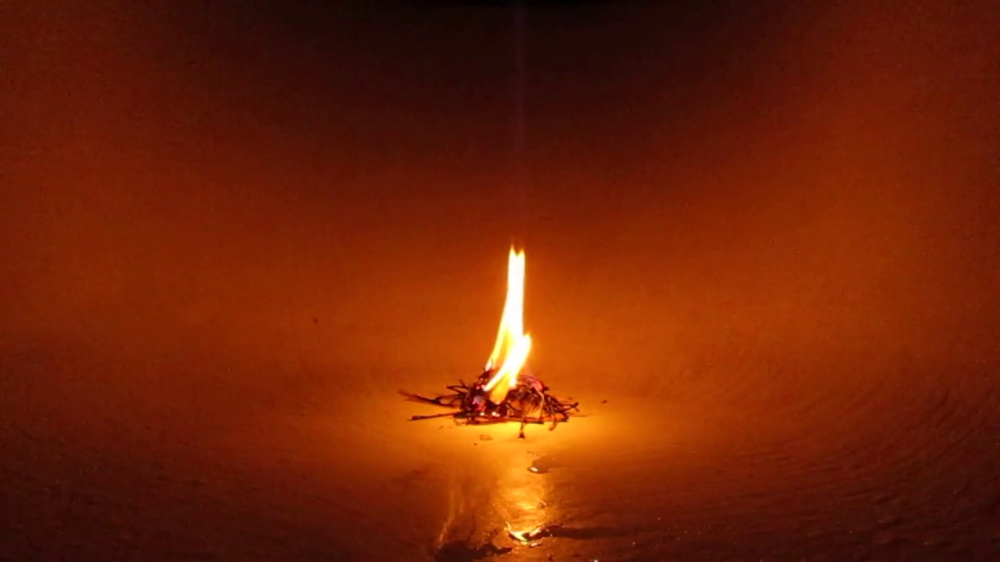

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step



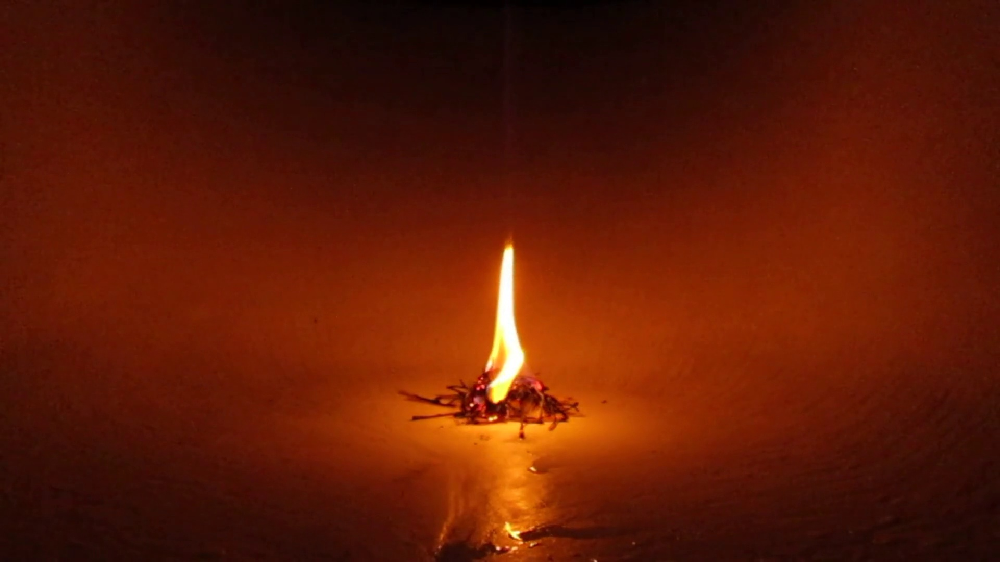

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step



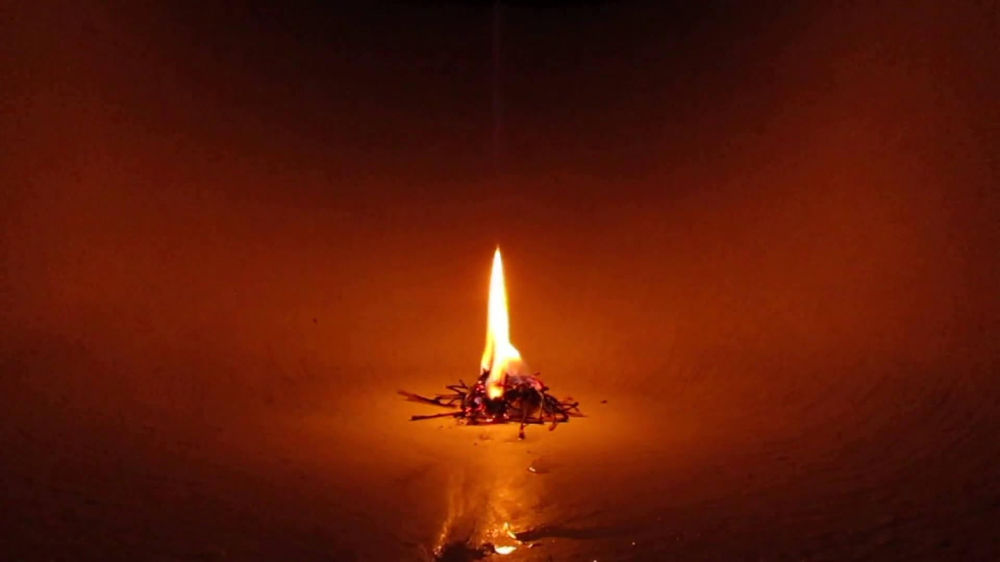

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step



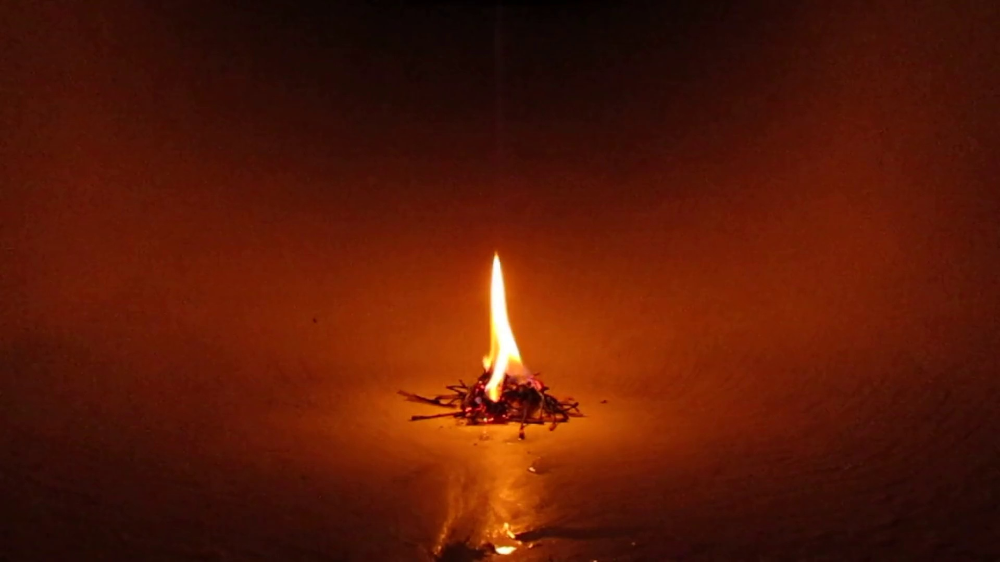

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



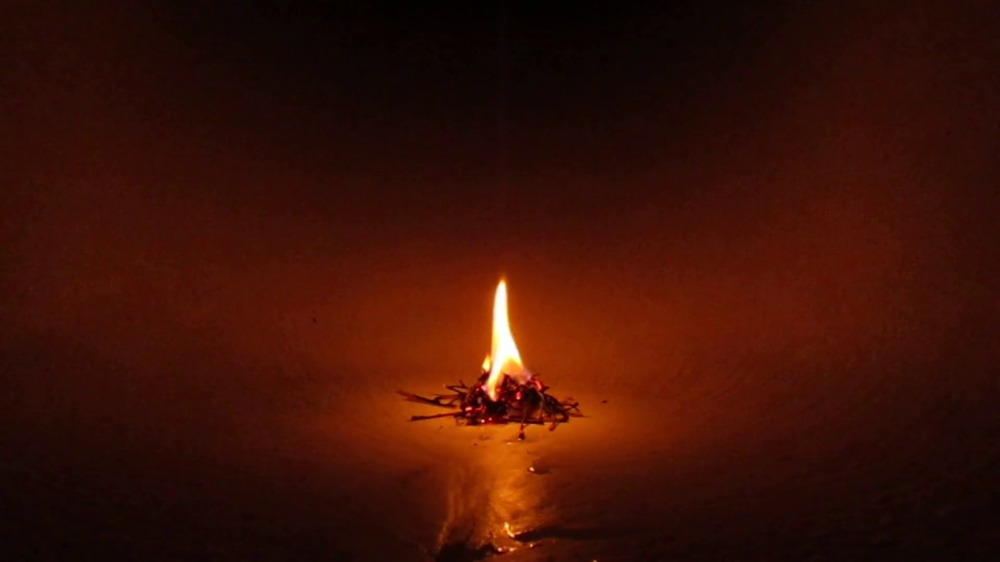

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step



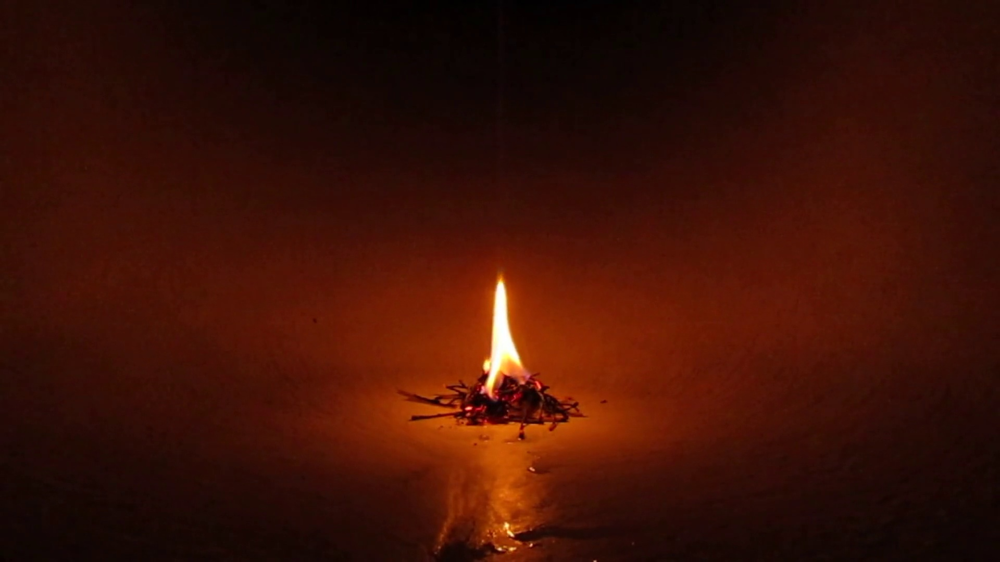

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step



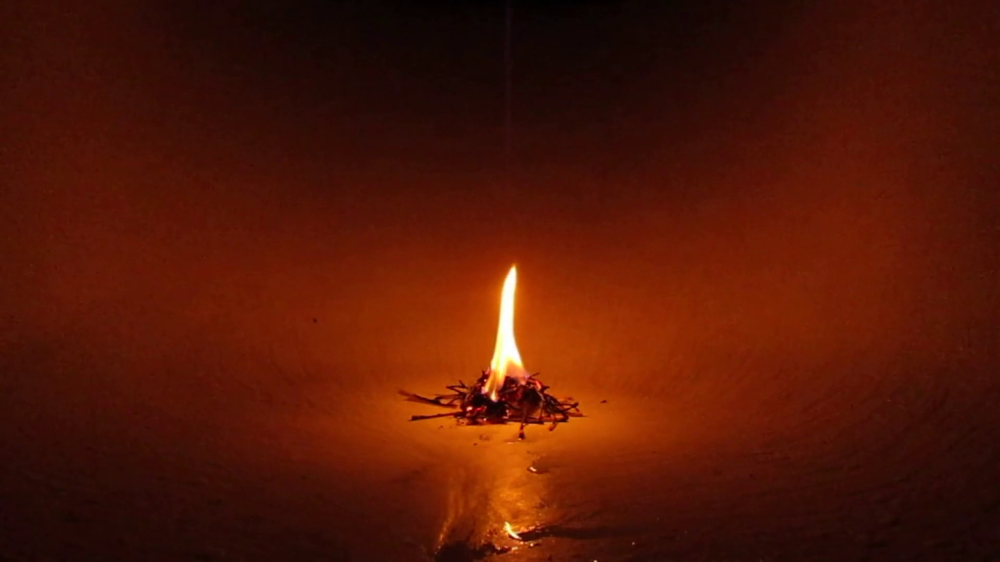

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step



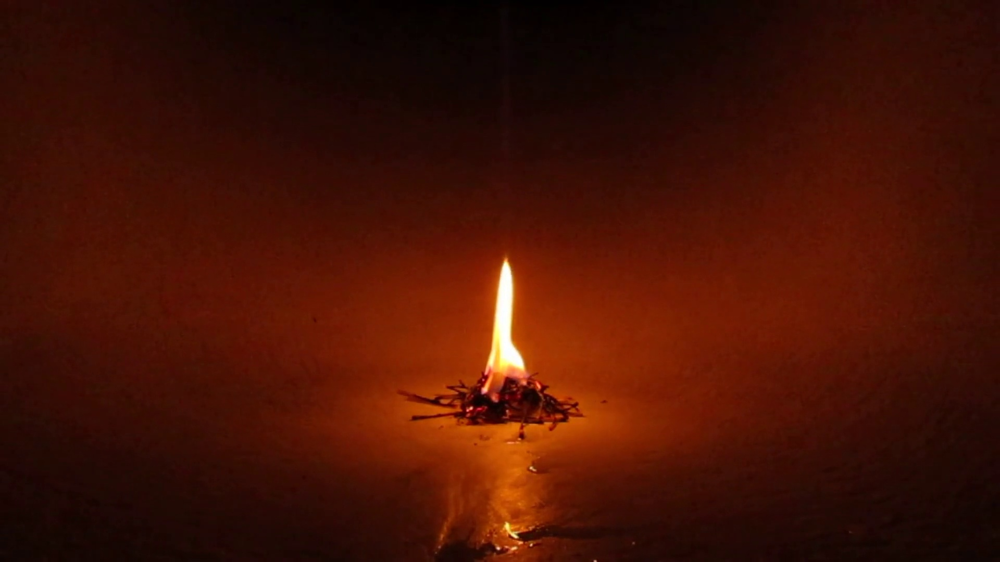

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step



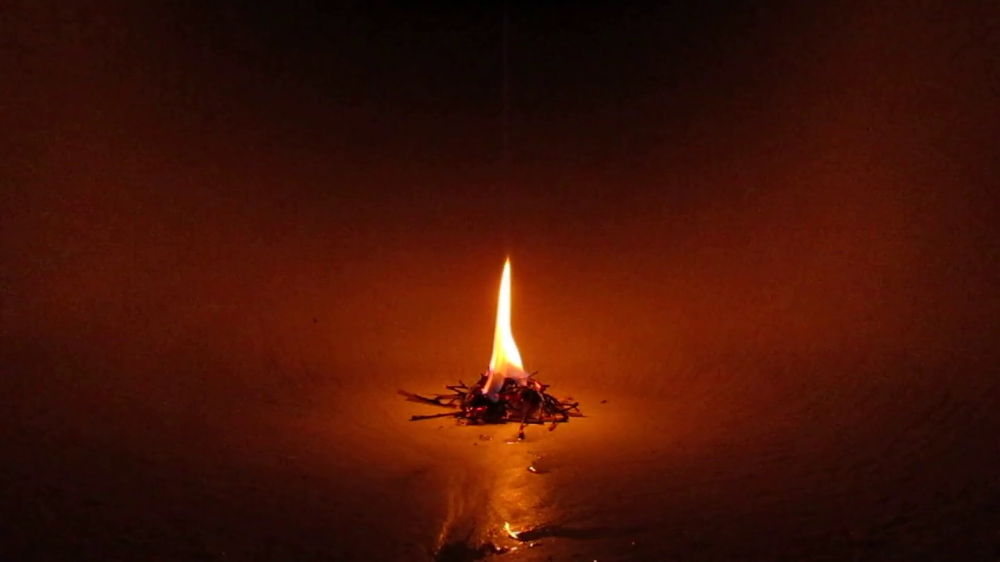

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step



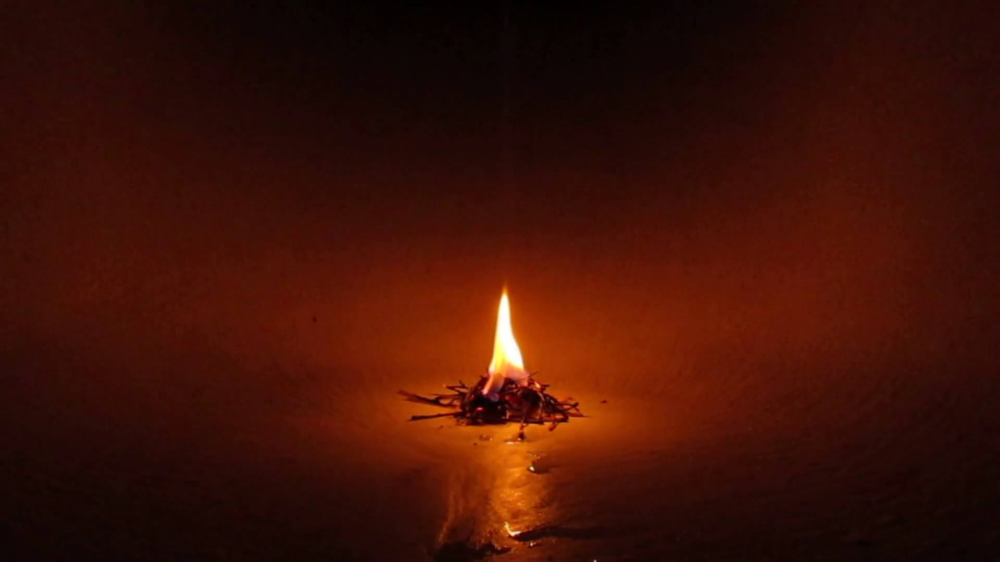

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step



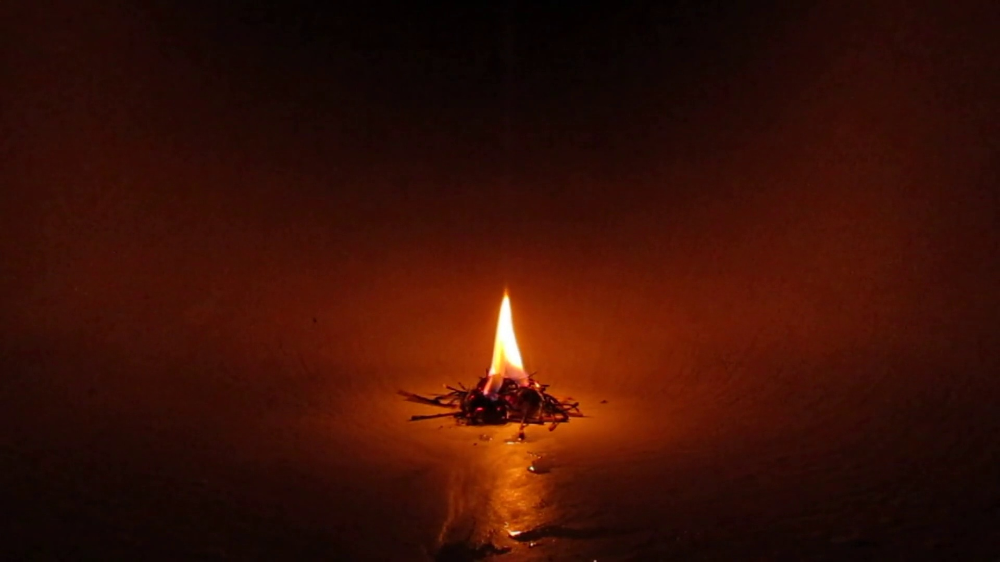

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step



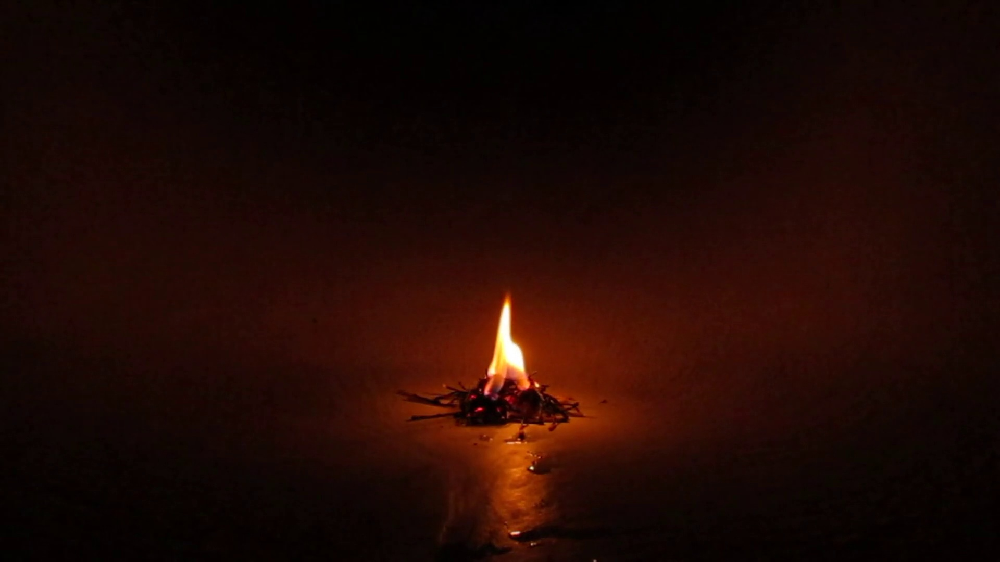

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



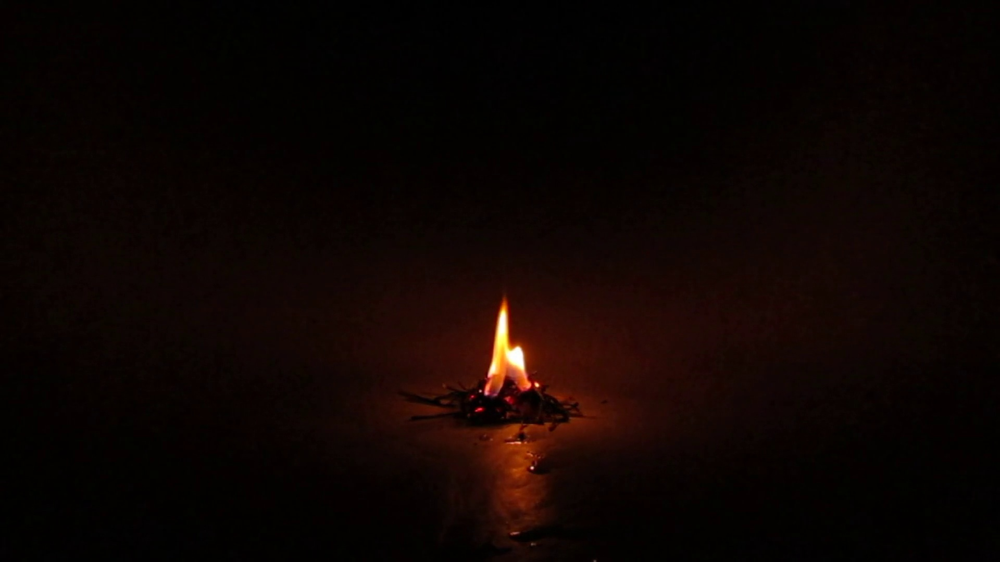

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step



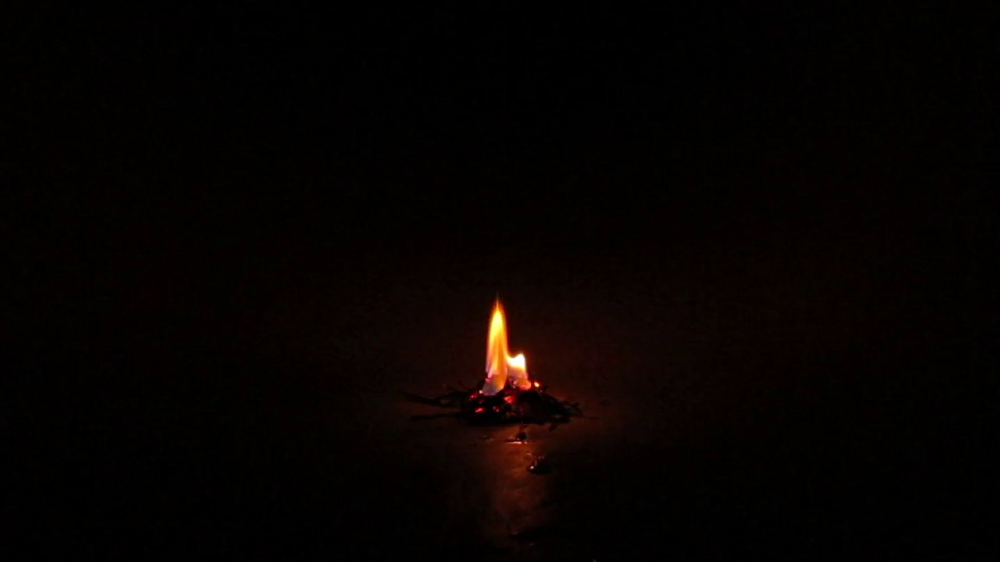

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



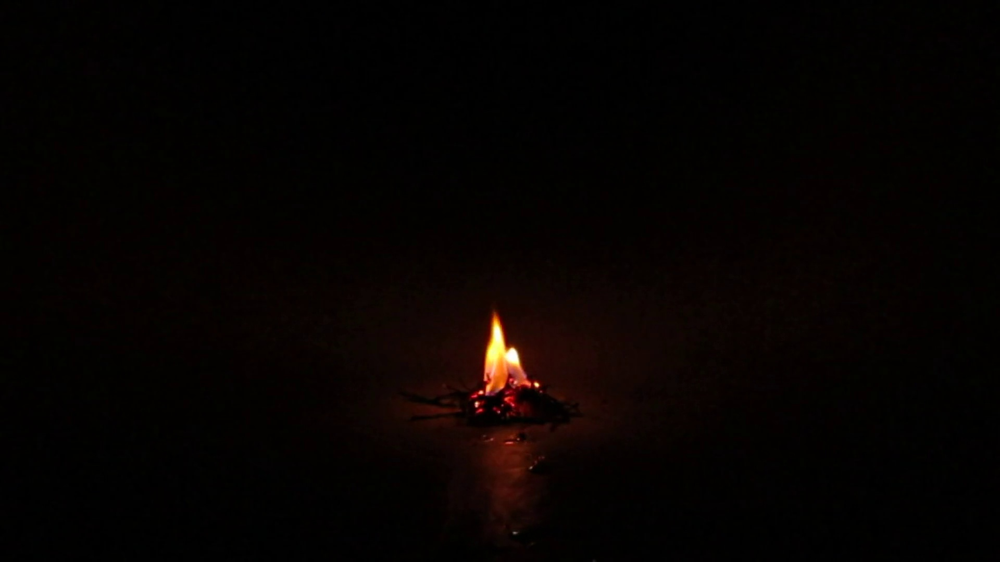

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step



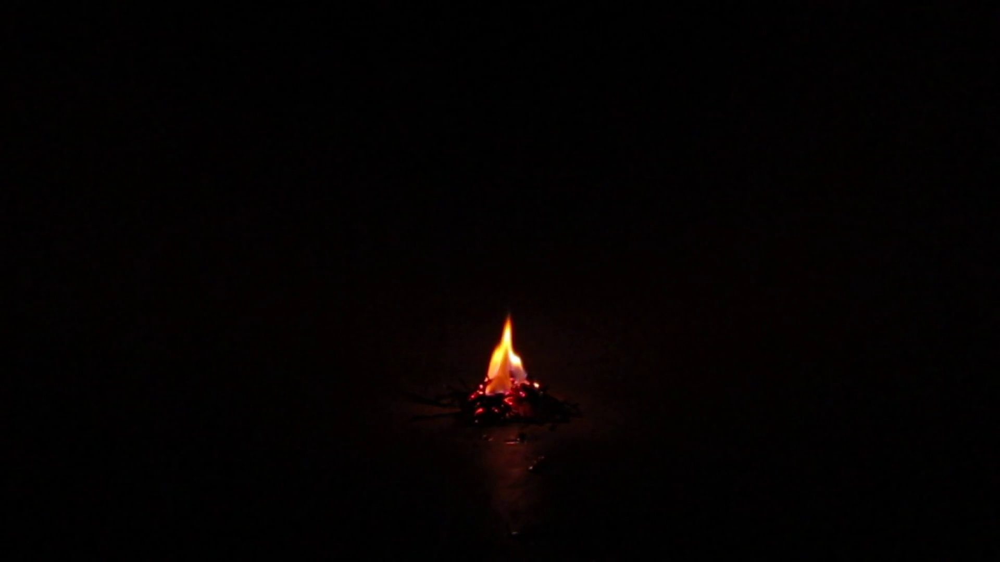

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step



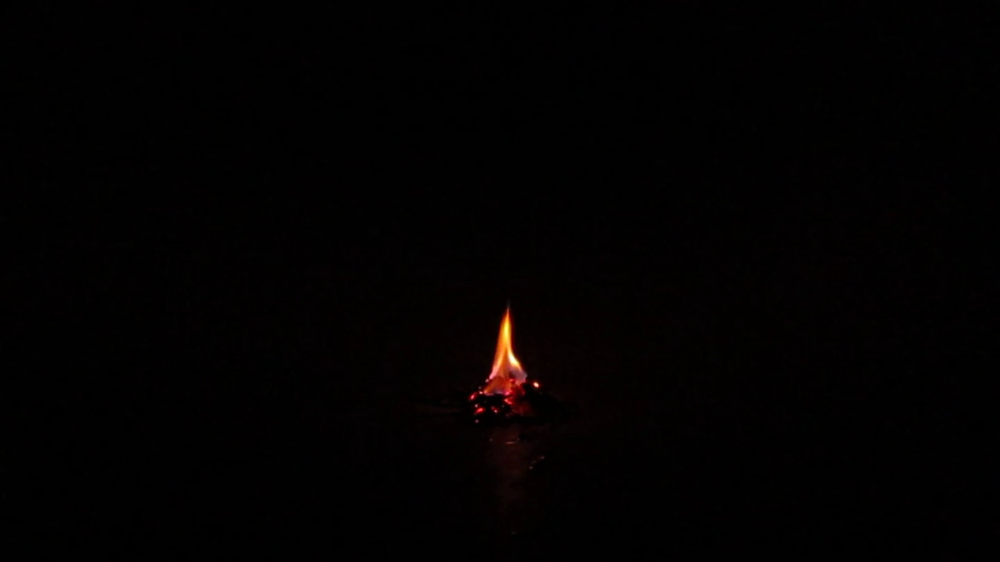

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step



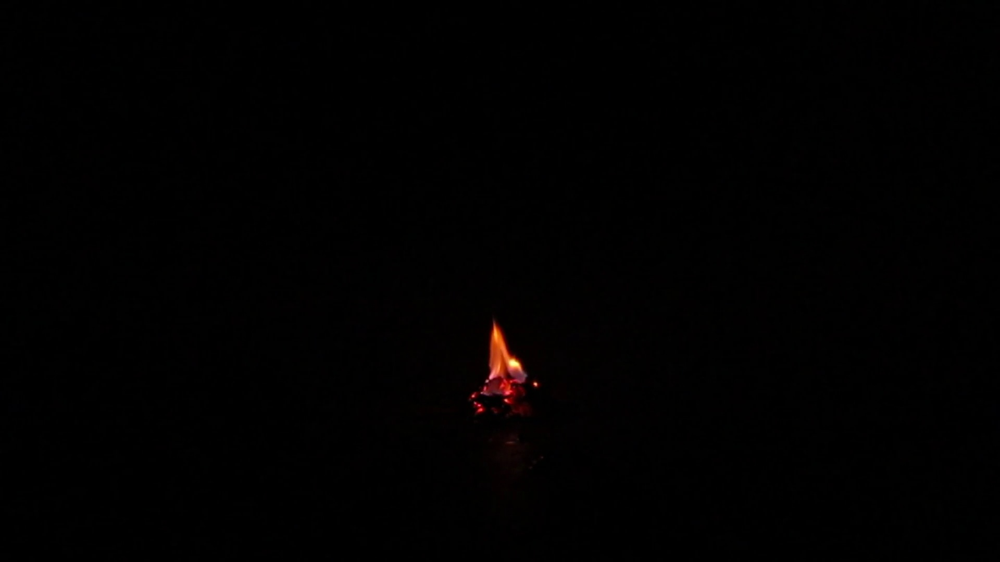

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step



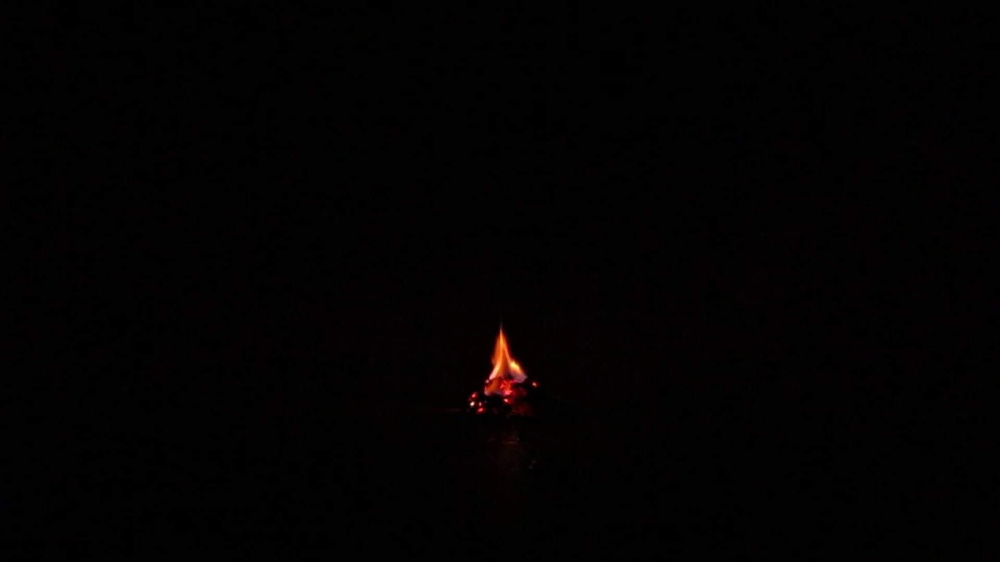

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step



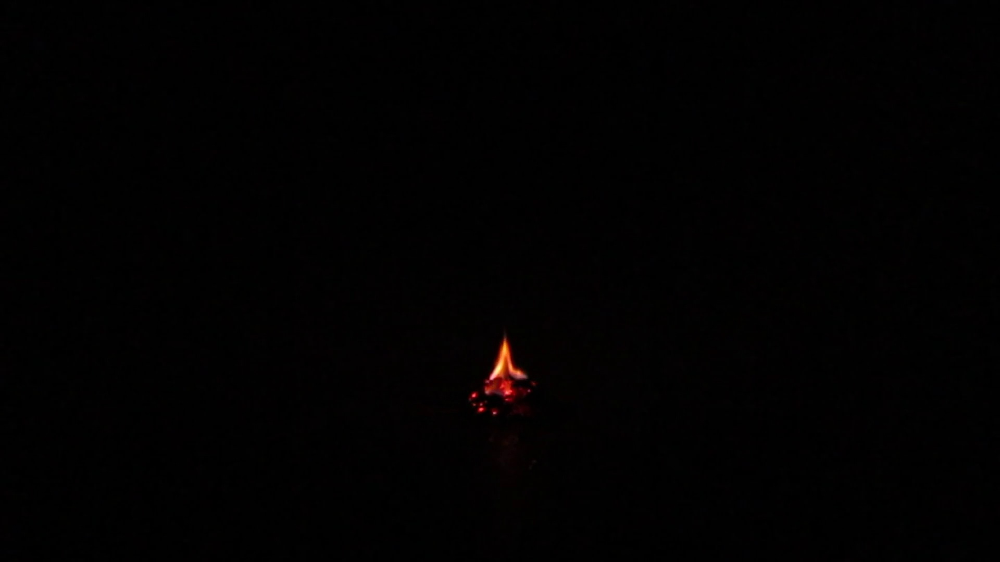

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step



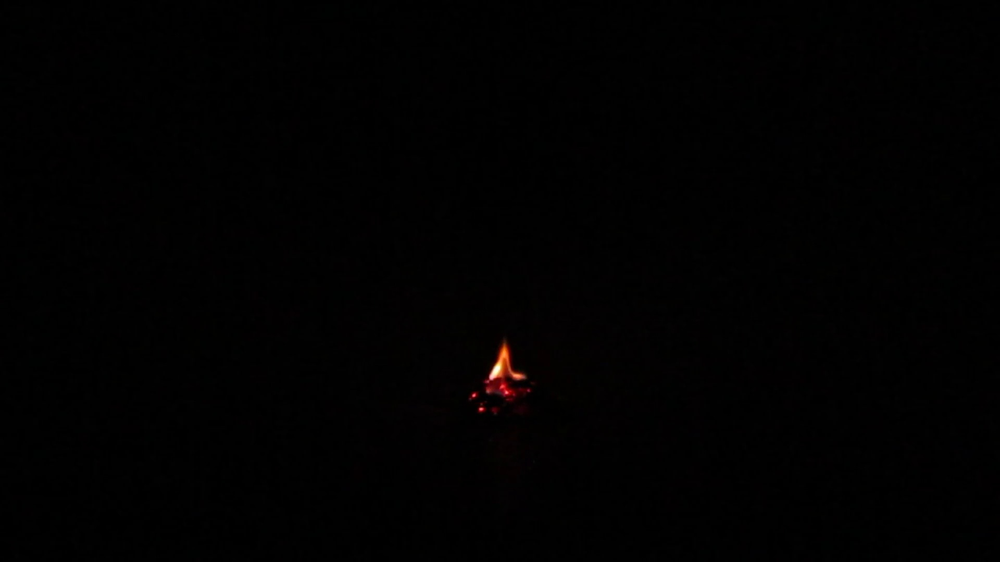

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step



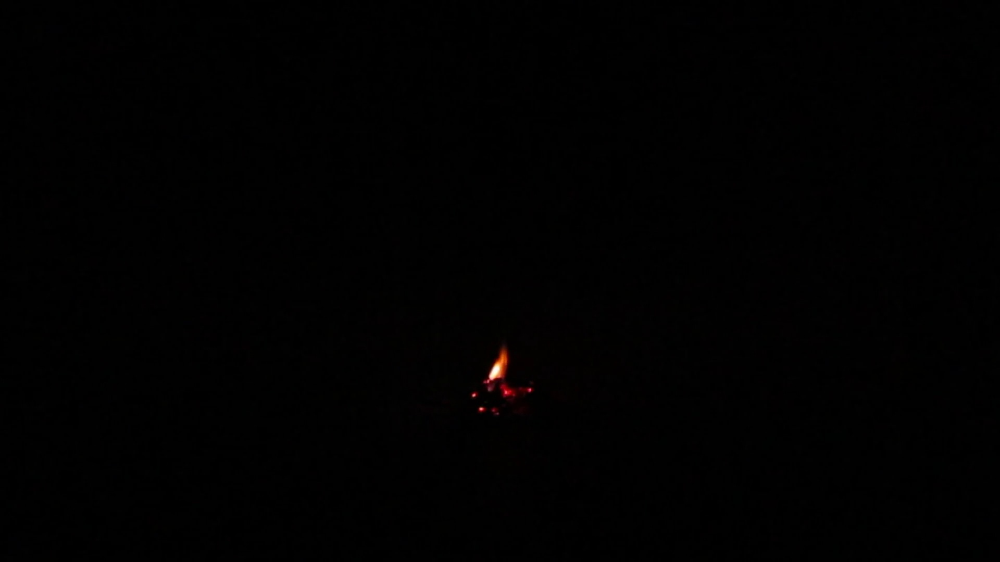

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step



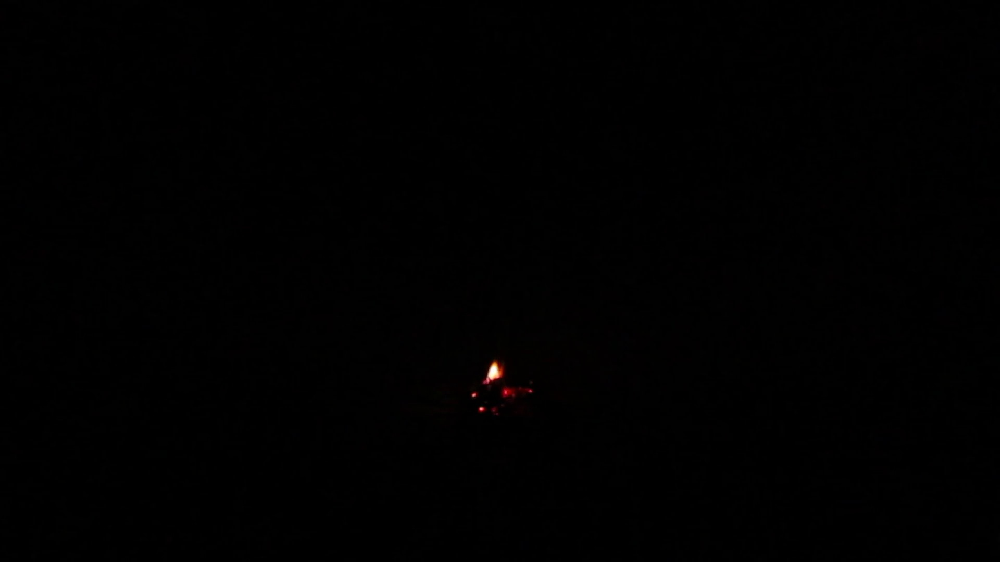

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step



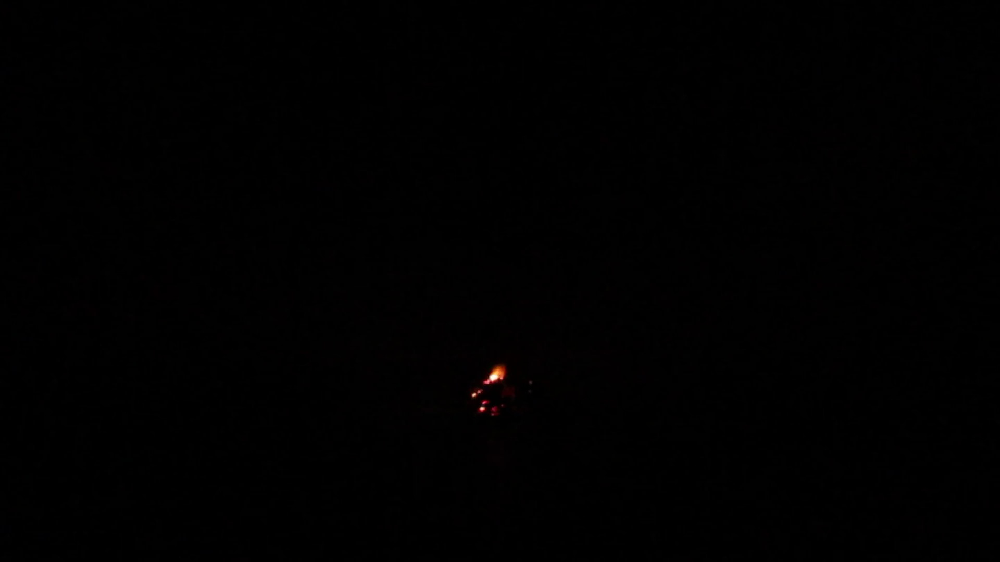

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step



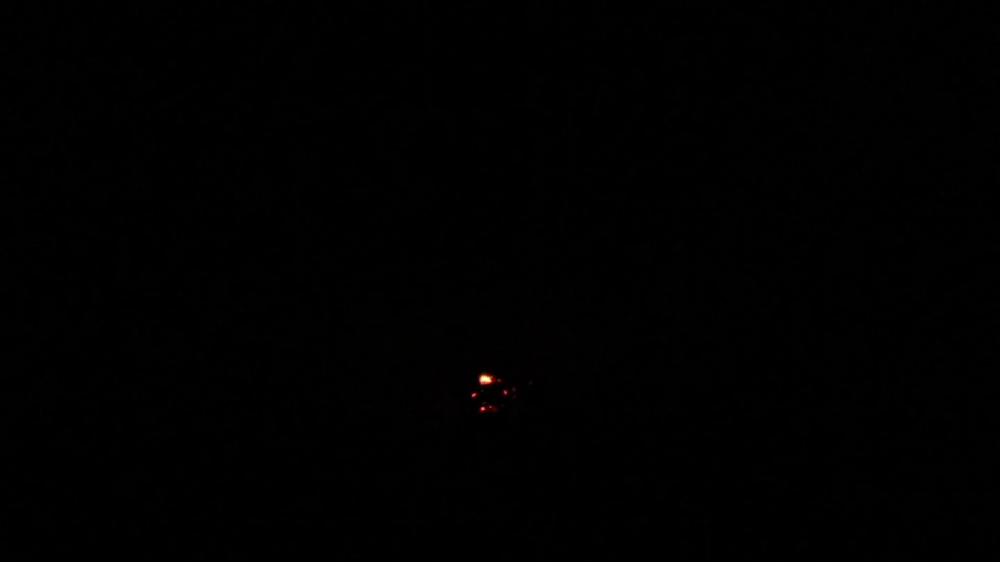

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step



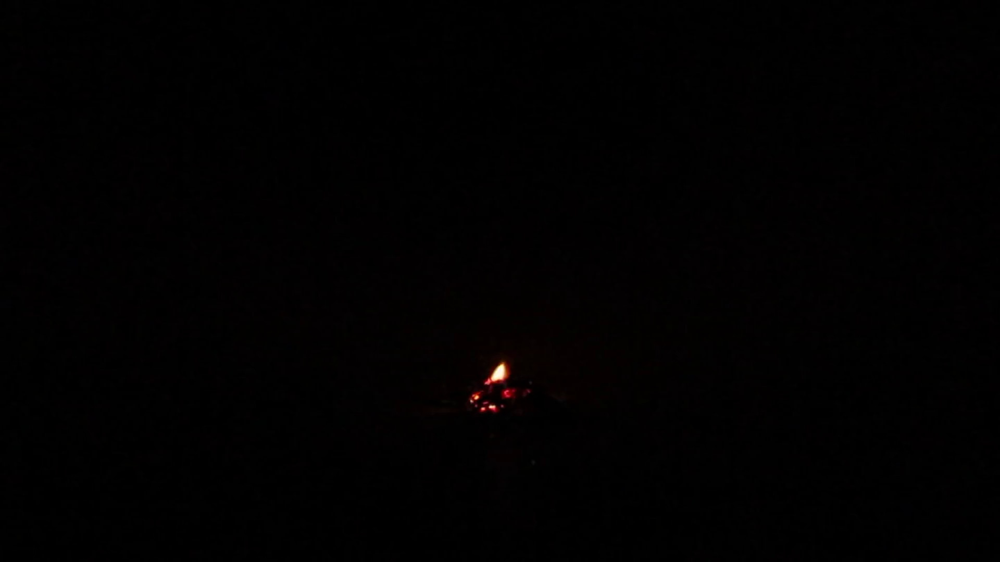

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step



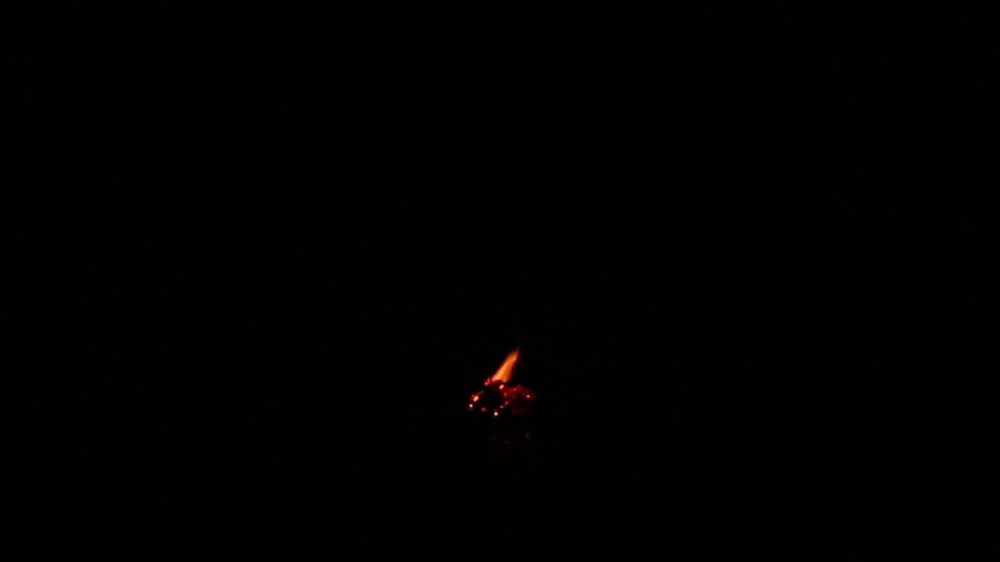

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step



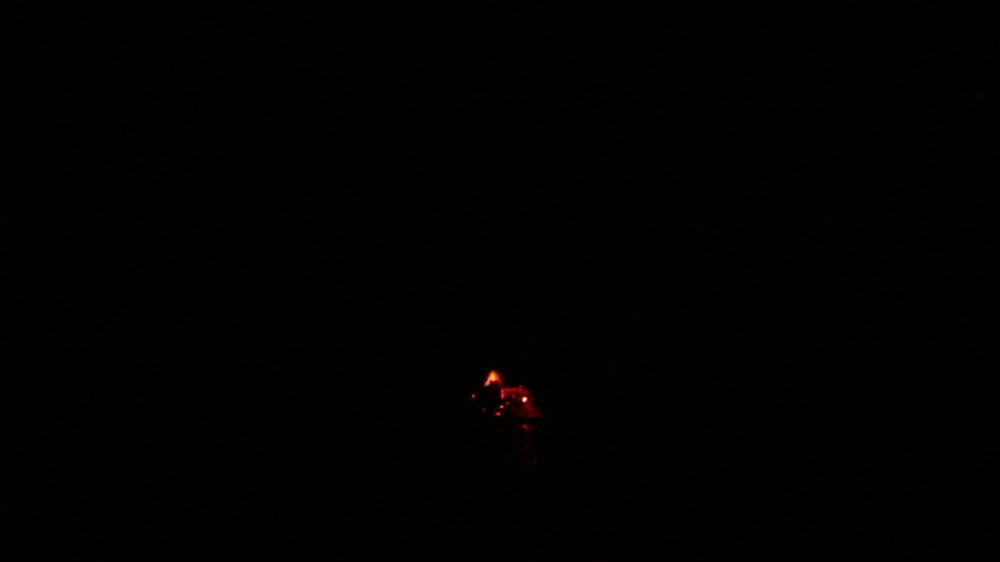

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step



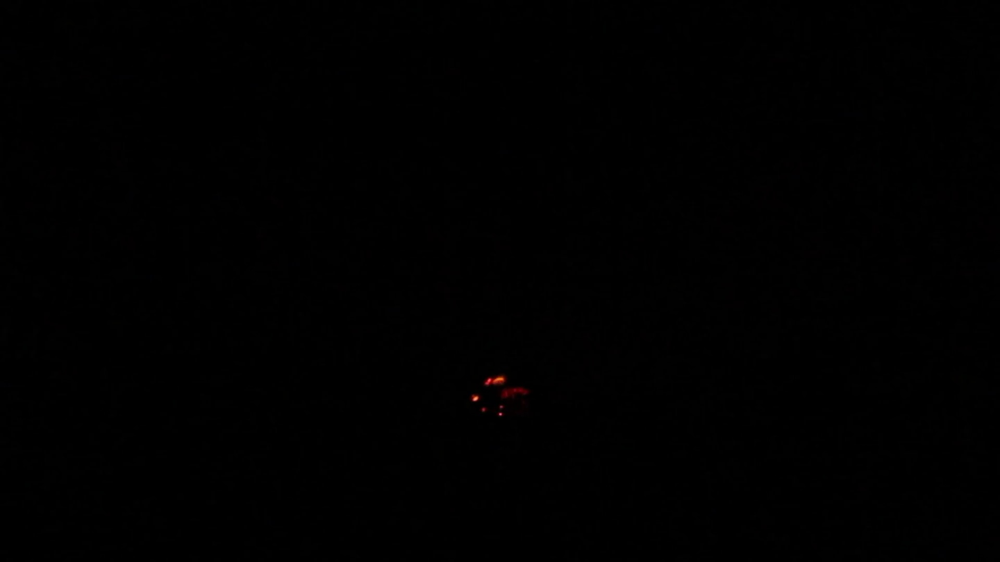

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step



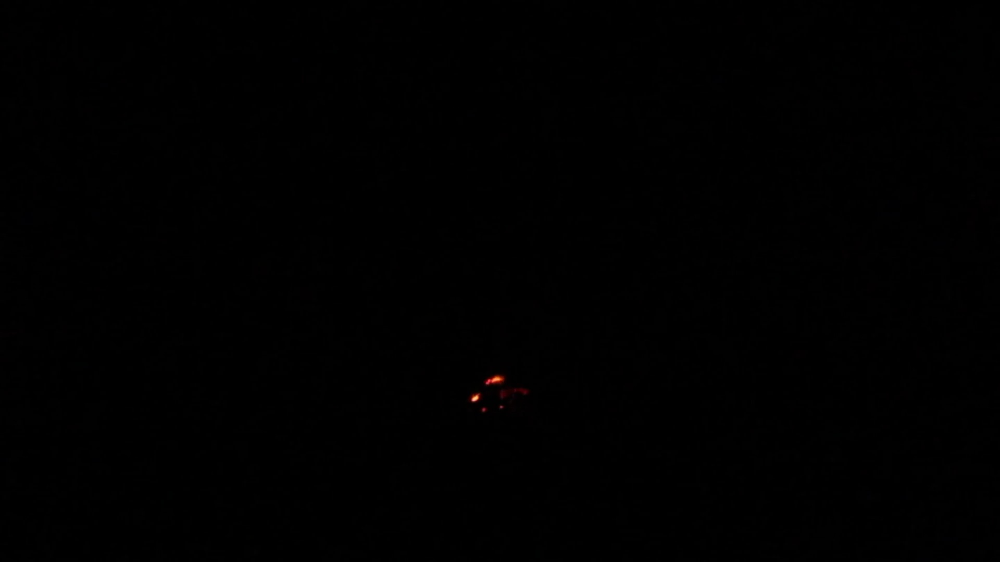

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step



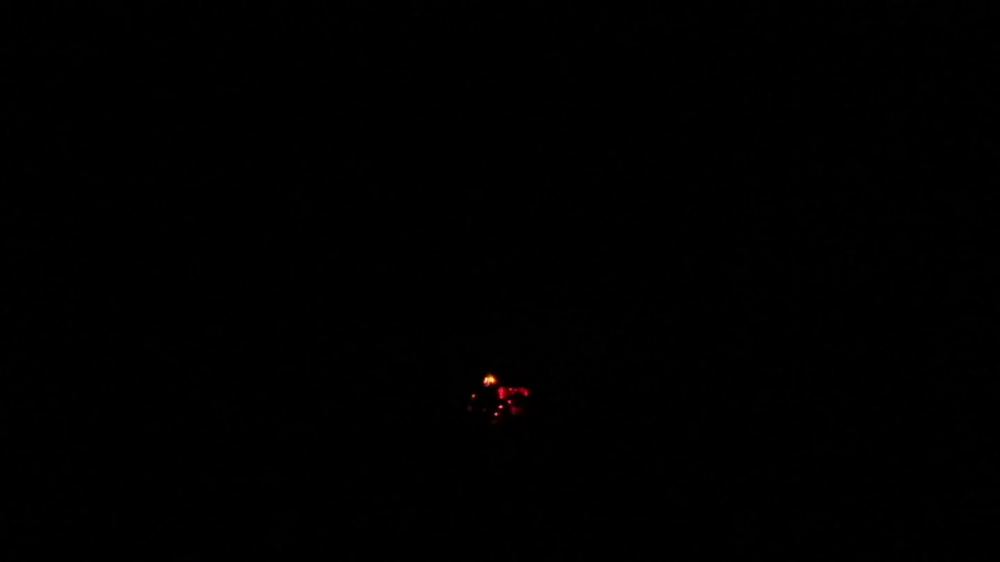

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Do you want to continue? (y/n): y



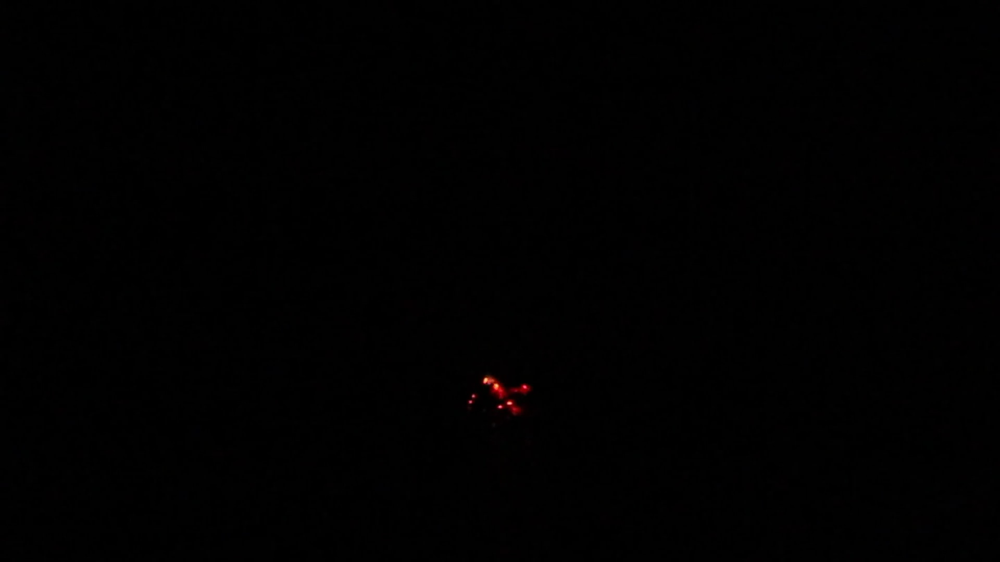

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step



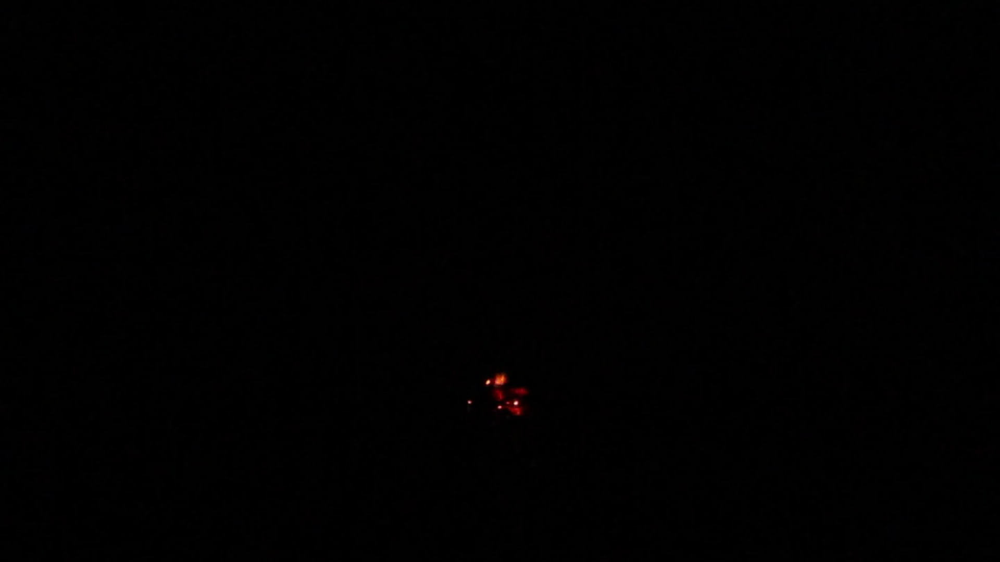

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step



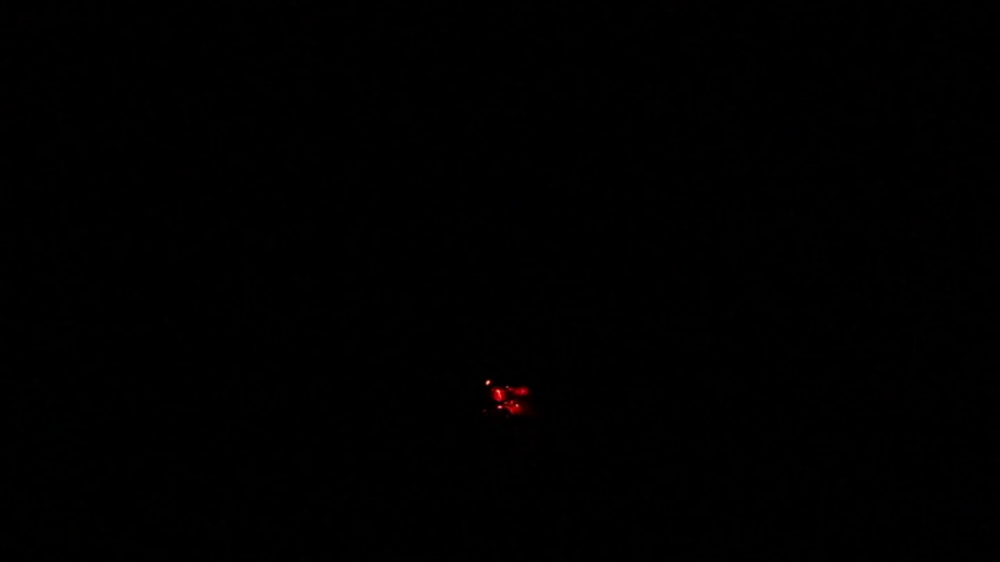

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step



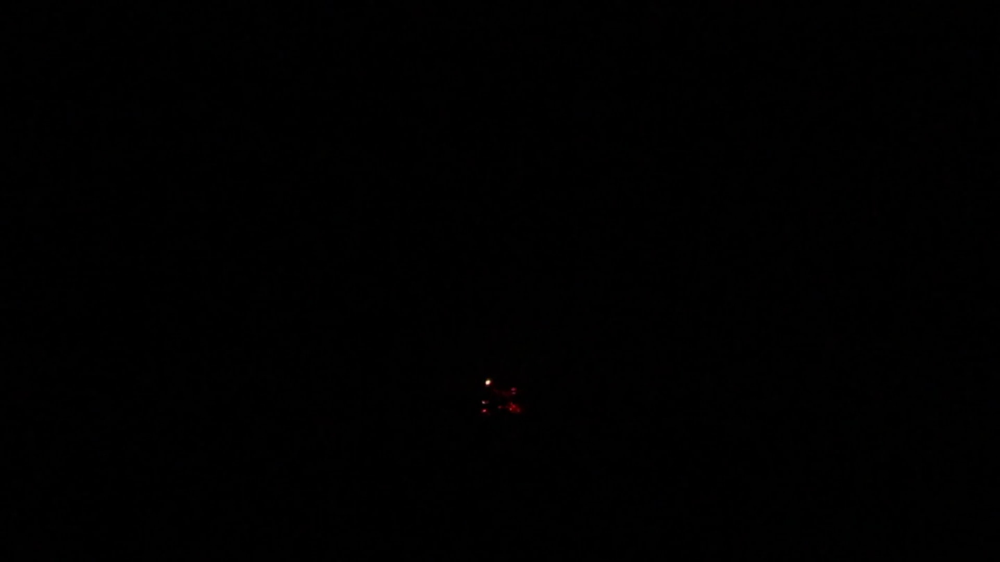

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step



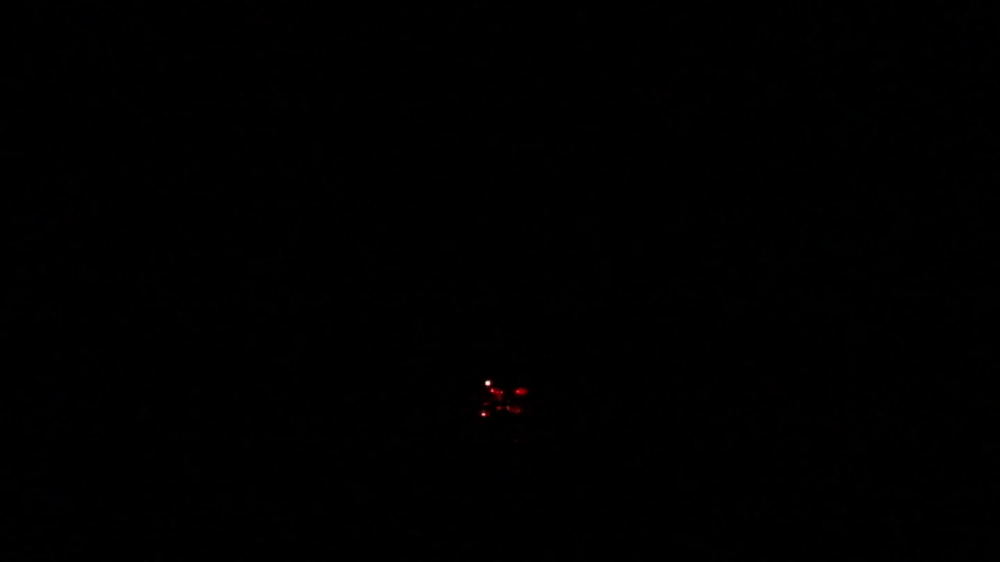

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step



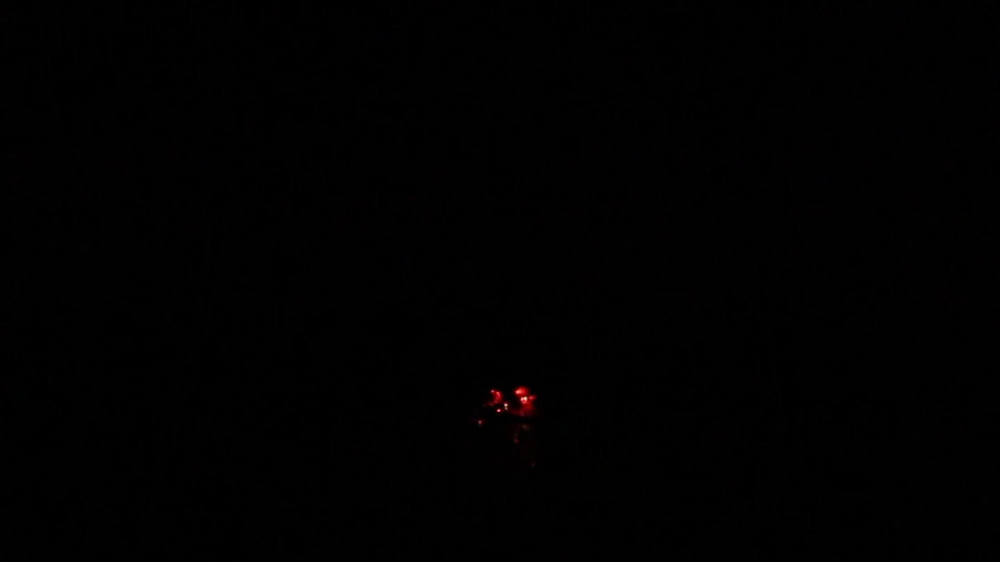

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step



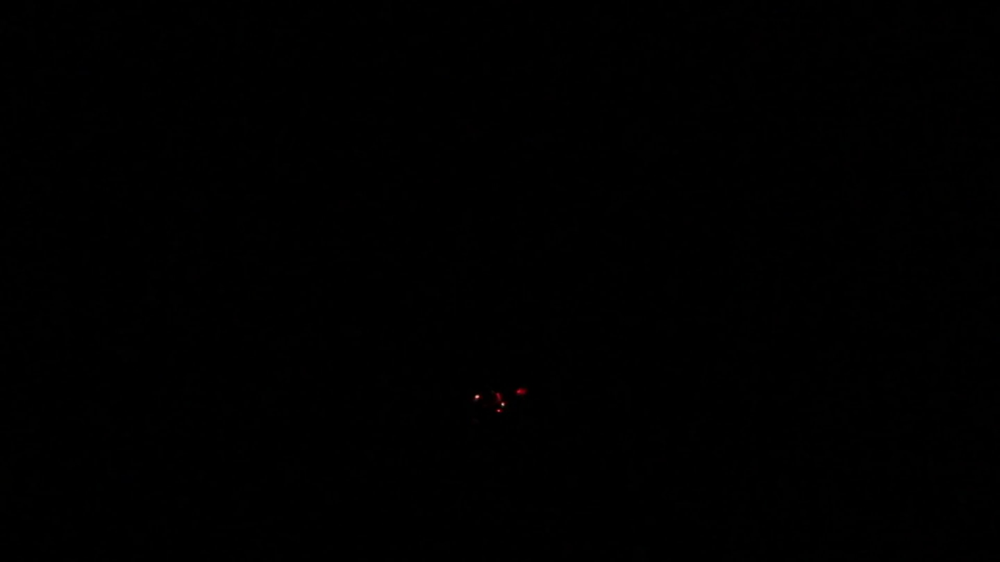

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step



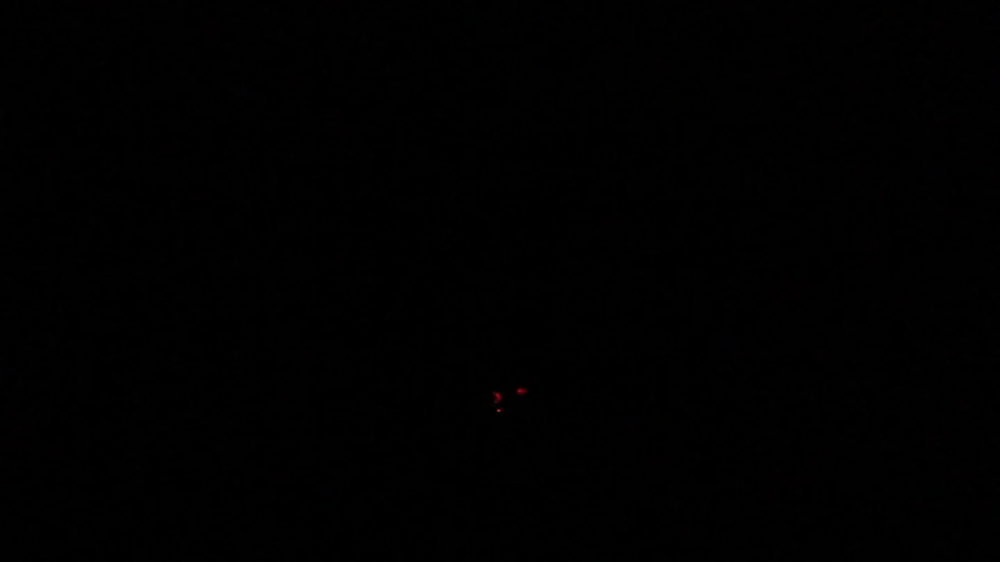

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step



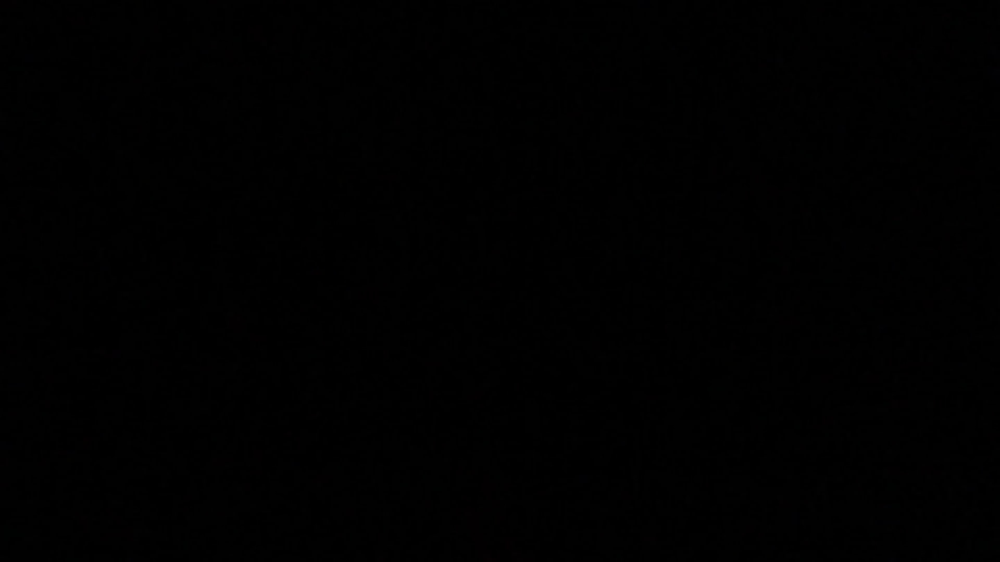

Logs have been written to 'frame_predictions.txt'.
Enter '1' to upload an image or '2' to upload a video: 1
Please upload an image file:


Saving images12345.jpeg to images12345.jpeg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


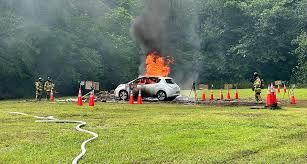

Prediction: No Fire
Do you want to continue? (y/n): y
Enter '1' to upload an image or '2' to upload a video: 1
Please upload an image file:


Saving smokeu.webp.PNG to smokeu.webp.PNG
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


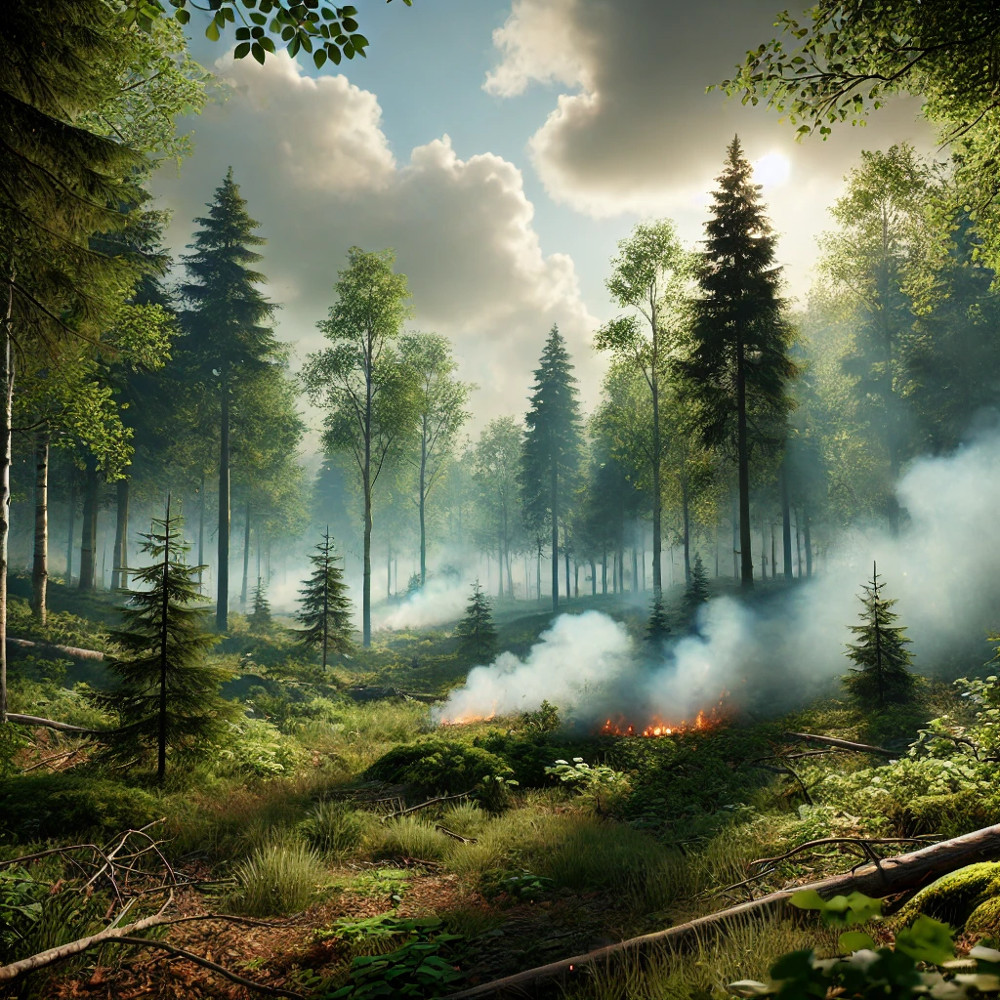

Prediction: Fire


KeyboardInterrupt: Interrupted by user

In [31]:
import cv2
import numpy as np
from keras.models import load_model
from google.colab import files
import base64
from IPython.display import HTML, display
import time

# Load your pre-trained model
# model = load_model('path_to_your_model.h5')

# Function to process video with reduced display updates and logging to file
def process_video(file_name):
    cap = cv2.VideoCapture(file_name)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    log_file = open("frame_predictions.txt", "w")  # Open a text file for logging predictions
    frame_number = 0
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break

            if frame_number % 15 == 0:  # Process every 15th frame
                frame_resized = cv2.resize(frame, (32, 32))
                frame_normalized = frame_resized.astype('float32') / 255.0
                frame_reshaped = np.expand_dims(frame_normalized, axis=0)
                prediction = model.predict(frame_reshaped)
                class_label = np.argmax(prediction)
                labels = ['No Fire', 'Fire']

                # Log the prediction
                log_file.write(f'Frame {frame_number}: {labels[class_label]}\n')

                # Optionally update display less frequently
                if frame_number % 15 == 0:
                    _, buffer = cv2.imencode('.jpg', frame)
                    frame_b64 = base64.b64encode(buffer).decode('utf-8')
                    display(HTML(f"<img src='data:image/jpeg;base64,{frame_b64}' style='width: 120px; height: 90px;'><p>Frame {frame_number}: {labels[class_label]}</p>"))

            frame_number += 1

    finally:
        cap.release()
        cv2.destroyAllWindows()
        log_file.close()  # Close the file
        print("Logs have been written to 'frame_predictions.txt'.")

# Step 2: Create a loop to allow continuous processing of images or videos
while True:
    # Ask user whether they want to upload an image or video
    choice = input("Enter '1' to upload an image or '2' to upload a video: ")

    if choice == '1':
        # Process Image
        print("Please upload an image file:")
        uploaded = files.upload()

        if uploaded:
            file_name = next(iter(uploaded))
            process_image(file_name)
        else:
            print("No file uploaded, please try again.")

    elif choice == '2':
        # Process Video
        print("Please upload a video file:")
        uploaded = files.upload()

        if uploaded:
            file_name = next(iter(uploaded))
            process_video(file_name)
        else:
            print("No file uploaded, please try again.")

    else:
        print("Invalid input. Please choose '1' for image or '2' for video.")

    # Ask if the user wants to continue
    continue_choice = input("Do you want to continue? (y/n): ").lower()
    if continue_choice == 'n':
        print("Exiting...")
        break
    elif continue_choice != 'y':
        print("Invalid input. Exiting...")
        break

**live video code**


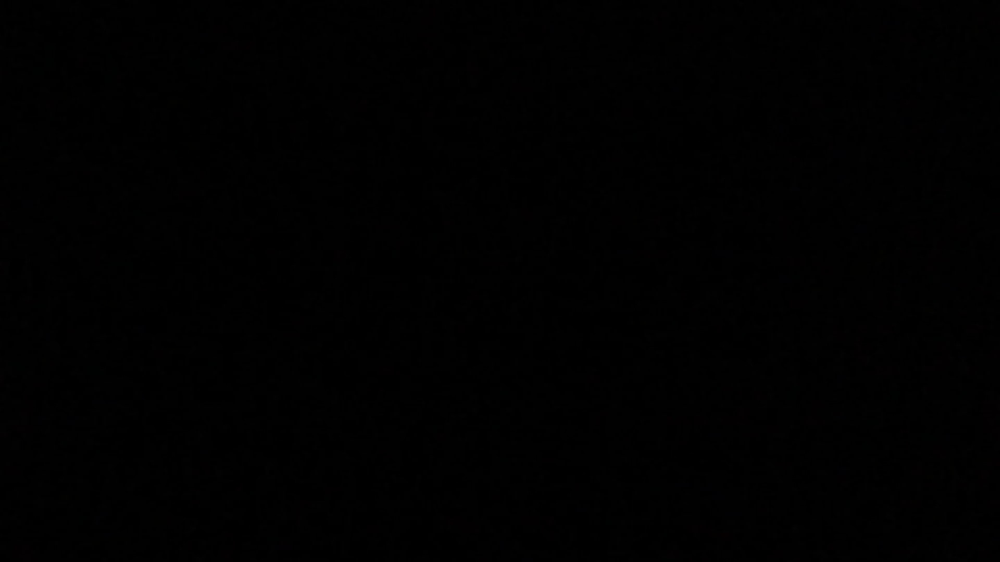

Frame Prediction: No Fire
Enter '1' to upload an image or '2' to upload a video: n
Invalid input. Please choose '1' for image or '2' for video.
Do you want to continue? (y/n): n
Exiting...


In [32]:
from google.colab import files
import cv2
import numpy as np
from keras.models import load_model
from IPython.display import display, clear_output, Image
import base64
import time

# Load your pre-trained model
# model = load_model('path_to_your_model.h5')

def process_video(file_name):
    cap = cv2.VideoCapture(file_name)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break

            frame_resized = cv2.resize(frame, (32, 32))  # Resize to match model's expected input
            frame_normalized = frame_resized.astype('float32') / 255.0
            frame_reshaped = np.expand_dims(frame_normalized, axis=0)
            prediction = model.predict(frame_reshaped)
            class_label = np.argmax(prediction)
            labels = ['No Fire', 'Fire']

            # Encode the frame to display in the notebook
            _, buffer = cv2.imencode('.jpg', frame)
            frame_b64 = base64.b64encode(buffer).decode('utf-8')

            # Clear previous output and display new frame with prediction
            clear_output(wait=True)
            display(Image(data=buffer, format='png', width=400, height=300))
            print(f'Frame Prediction: {labels[class_label]}')

            time.sleep(0.5)  # Slow down the loop to create a slow-motion effect (0.5 seconds per frame)

    finally:
        cap.release()
        cv2.destroyAllWindows()

# Function to handle file uploads and processing
def upload_and_process_video():
    print("Please upload a video file:")
    uploaded = files.upload()

    if uploaded:
        file_name = next(iter(uploaded))
        process_video(file_name)
    else:
        print("No file uploaded. Please try again.")

# This function starts the process
upload_and_process_video()

# Step 2: Create a loop to allow continuous processing of images or videos
while True:
    # Ask user whether they want to upload an image or video
    choice = input("Enter '1' to upload an image or '2' to upload a video: ")

    if choice == '1':
        # Process Image
        print("Please upload an image file:")
        uploaded = files.upload()

        if uploaded:
            file_name = next(iter(uploaded))
            process_image(file_name)
        else:
            print("No file uploaded, please try again.")

    elif choice == '2':
        # Process Video
        print("Please upload a video file:")
        uploaded = files.upload()

        if uploaded:
            file_name = next(iter(uploaded))
            process_video(file_name)
        else:
            print("No file uploaded, please try again.")

    else:
        print("Invalid input. Please choose '1' for image or '2' for video.")

    # Ask if the user wants to continue
    continue_choice = input("Do you want to continue? (y/n): ").lower()
    if continue_choice == 'n':
        print("Exiting...")
        break
    elif continue_choice != 'y':
        print("Invalid input. Exiting...")
        break